# Исследования рынка общепита в Москве для принятия решения об открытии нового заведения

> ### Ход исследования
>
> 1. [Открытие данных](#start)
> 2. [Предобработка данных](#preprocessing)
> 3. [Анализ:](#analysis)
> - [категорий заведений в представленных данных](#category)
> - [количества посадочных мест в заведениях по категориям](#seats)
> - [соотношения сетевых и несетевых заведений в датасете](#chain)
> - [категорий заведений, которые чаще являются сетевыми](#chain_category)
> - [топ-15 популярных сетей в Москве](#top_15)
> - [общего количества заведений и количества заведений каждой категории в разрезе по административным округам](#district)
> - [распределения средних рейтингов по категориям заведений](#rating)
> - [распределения средних рейтингов заведений каждого района с помощью построения фоновой картограммы (хороплета)](#map)
> - [распределения заведений по районам с помощью их отображения на карте ввиде кластеров](#cluster)
> - [топ-15 улиц по количеству заведений](#street)
> - [заведений, которые являются единственными объектами общепита на той или иной улице](#street_one_obj)
> - [влияния удалённости от центра на цены в заведениях](#middle_avg_bill)
> - [круглосуточных заведений и их зависимость от расположения и категории заведения](#24/7)
> - [заведений с плохими рейтингами](#low_rating)
> 4. [Общий вывод](#conclusion)
>> * [Исследование по открытию кофейни](#coffee_house)
>> * [Рекомендации по открытию кофейни](#coffee_house_recomendation)

### Открытие данных
<a id="start"></a> 

Данные о заведениях общественного питания Москвы получим из файла `'moscow_places.csv'`. 

In [1]:
#импорт библиотек, необходимых для проведения анализа
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from plotly import graph_objects as go
import seaborn as sns

#вызываем функцию игнорирования предупреждений
import warnings
warnings.filterwarnings('ignore')

In [2]:
#создадим переменную с расположением адреса, в котором находится выгружаемый файл на локальном компьюетере
path = 'C://Users//vladi//Downloads//'

#открываем файл с данными
try:
    data =  pd.read_csv(path + 'moscow_places.csv') 
except:
    data = pd.read_csv('https://')

#выведем на экран первые 5 строк, выгруженного датасета
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


О качестве данных ничего неизвестно, поэтому перед тем как приступать к целям исследования, требуется их обзор и предобработка. Сперва изучим общую информацию о датасете:

In [3]:
#изучим общую информацию о датасете
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Всего для анализа в имеющемся датасете имеется 8 406 заведений.

Имеются пропуски в данных, посмтрим сколько их:

In [4]:
#выведем долю пропусков в %
pd.DataFrame(
    round(data.isna().mean()*100)
).rename(
    columns={0:'Доля пропусков в %'}
).style.format(
    '{:.0f}'
).background_gradient(
    'coolwarm'
)

,Доля пропусков в %
name,0
category,0
address,0
district,0
hours,6
lat,0
lng,0
rating,0
price,61
avg_bill,55


В таких столбцах как имя, категория, адрес, район, широта и долгота, рэйтинг, сеть - отсутстсуют пропуски.

В остальных столбцах - доля пропусков различная, при этом зачастую объяснимая - соответствует описанию данных (например, middle_coffee_cup=94% пропусков, т.к. цена указана только для тех заведений, где в столбце "avg_bill" определена цена для чашки капучино).

Типы даннных соответствуют их значениям, кроме "chain" - преобразуем его в булев тип на следующем этпае в предобработке данных.

### Предобработка данных
<a id="preprocessing"></a> 

На предыдущем этапе мы вывели долю пропусков, но данные с пропусками удалять не будем, т.к. в ряде столбцов они логичны, а в других случаях - нам потребуются данные из оставшихся столбцов. Заполнить мы их тоже ничем не можем, т.к. нет дополнительных данных для корректного заполнения.

Поэтому на этом этапе сделаем следующее:
- приведем столбец "chain" к булеву типу данных;
- создадим столбец street с названиями улиц из столбца с адресом;
- создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
    - логическое значение True — если заведение работает ежедневно и круглосуточно;
    - логическое значение False — в противоположном случае;
- удалим явные дубликаты, если они есть;
- осуществим проверку на неявные дубликаты и удалим их, в случае наличия таковых.

In [5]:
#переводим столбец "chain" к типу данных bool
data['chain'] = data['chain'].astype('bool')

#создадим столбец street с названиями улиц из столбца с адресом
data['street'] = data.apply(
    lambda x: x['address'].split(', ')[1], #разделим все значения по запятой и выберем 2-е значение в списке (там указана улица)
    axis=1 #применем эту функцию для каждой строки в столбце
)

#создадим столбец is_24/7 с обозначениями True, если заведение работает 24/7, и False - если нет
data['is_24/7'] = np.where(data['hours']=='ежедневно, круглосуточно', True, False)

#удалим явные дубликаты и сразу пересчитаем индексы
data = data.drop_duplicates().reset_index(drop=True)

#выведем информацию о преобразованном датасете и его первые 5 строк
display(
    data.info(),
    data.head()
)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   bool   
 13  seats              4795 non-null   float64
 14  street             8406 non-null   object 
 15  is_24/7            8406 non-null   bool   
dtypes: bool(2), float64(6), 

None

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,False,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,False,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,False,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,False,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,True,148.0,Правобережная улица,False


Как видим абсолютные дубликаты отсутствует - количество заведений не изменилось. Типы данных преобразовали, новые столбцы добавили. Осуществим еще проверку на неявные дубликаты.

In [6]:
#приведем содержимое столбцов "name" и "address" к нижнему регистру
data['name'] = data['name'].str.lower()
data['address'] = data['address'].str.lower()

#удалим строки датафрейма, в которых названия и адрес заведений сопадают
data = data[~data[['name', 'address']].duplicated()].reset_index(drop=True)

#выведем количество строк преобразованного датафрейма
len(data)

8402

Получается было выявлено и удалено 4 неявных дубликата.

Переходим к анализу данных.

### Анализ данных
<a id="analysis"></a> 

Осуществим анализ посредством построения графиков.

**Анализ категорий заведений, в представленных данных:**
<a id="category"></a> 

In [7]:
#сформируем таблицу с данными о категориях, к которым относятся заведения, и их количестве
data_category = data.category.value_counts( #посчитаем количество каждого из уникальных значений категорий
        ascending=True #по возрастанию
    ).reset_index(
    ).rename( #зададим столбцам корректные наименования
        columns={'index':'category', 
                 'category':'count'}
    )

#построим столбчатую диаграмму распределения заведений по категориям
fig = px.bar(
    data_category,
    x='count', #оси абсцисс передадим значения кол-ва заведений
    y='category', #оси ординат - наименования категорий заведений
    text='count'
)

#дадим название графику, а также подписи осям
fig.update_layout(
    title='Количество объектов общественного питания по категориям',
    xaxis_title='Количество заведений. шт.',
    yaxis_title='Категория заведения'
)

In [8]:
data_category

,category,count
0,булочная,256
1,столовая,315
2,быстрое питание,603
3,пиццерия,633
4,"бар,паб",764
5,кофейня,1413
6,ресторан,2042
7,кафе,2376


Из представленного графика видно, что больше всего заведений категории "кафе" (2 378 шт.) и чуть меньше "ресторан" (2 043 шт.). Также в тройку лидеров входит "кофейни" (1 413 шт.). Меньше всего заведений категории "булочная" (256 шт.).

Построим еще круговую диаграмму с долями:

In [9]:
#построим круговую диаграмму с долями, которую занимает каждая из категорий
fig = go.Figure(data=[go.Pie(labels=data_category['category'], # указываем значения, которые появятся на метках сегментов
                           values=data_category['count'])] # указываем данные, которые отобразятся на графике
               )
fig.update_layout(title='Доля объектов общественного питания по категориям', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Категория заведения',
                                    showarrow=False)]
                 )

Получается, что на кафе и рестораны приходится больше 50% заведений, а тройка лидеров (+кофейни) покрывает почти 70% всех заведений.

**Анализ количества посадочных мест в заведениях по категориям:**
<a id="seats"></a> 

Помним, что не для всех заведений отображено количество посадочных мест, поэтому для анализа сформируем датафрейм, в котором для заведений отображено количество посадочных мест (таких заведений чуть больше половины от всех анализируемых заведений) и построим для каждой категории заведений график распределения количества посадочных мест:

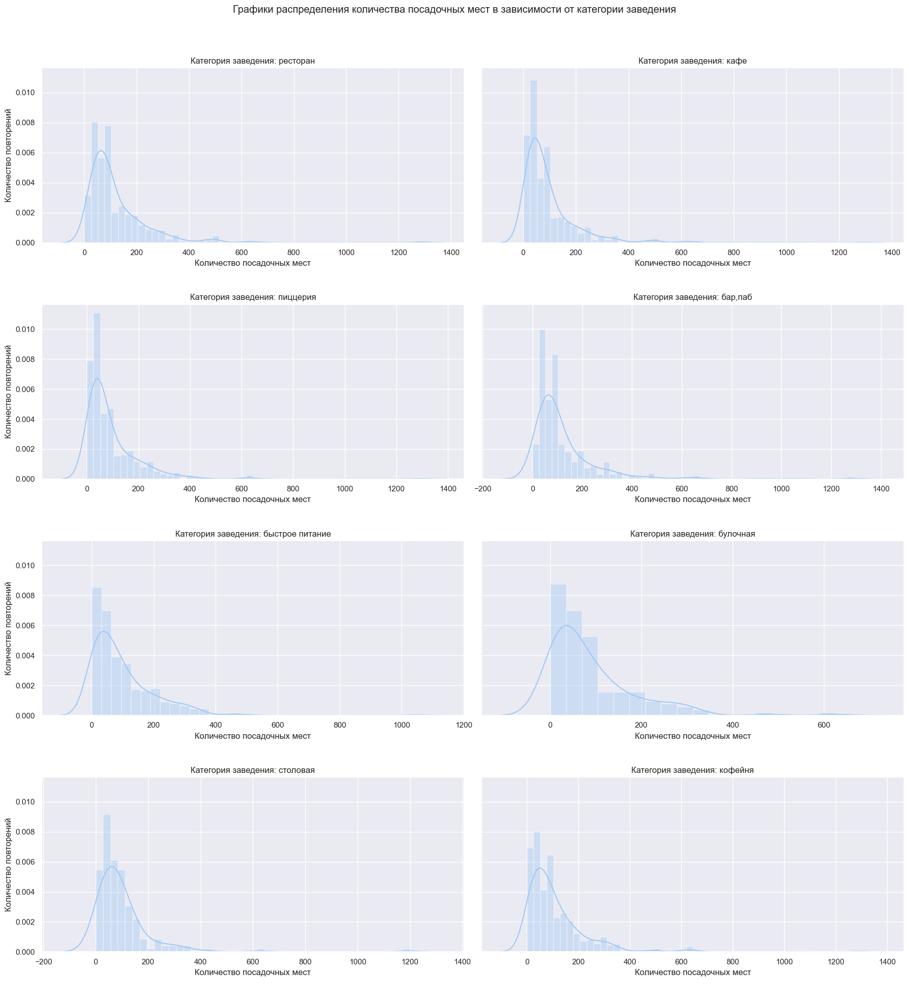

In [11]:
#создаем датафрейм, в котором отсутстсвуют пропущенных значения в столбце 'seats'
data_seats = data[data['seats'].isna()==False]

#задаем цветовую палитру
sns.set_palette('pastel')

#зададим сетку из 4х2 подграфиков, которая будет содеражть наши распредления
fig, axes = plt.subplots(4, 2, sharey=True)

#зададим размер одного подграфика
sns.set(rc={'figure.figsize': (18, 20)})

#даем название графика
fig.suptitle('Графики распределения количества посадочных мест в зависимости от категории заведения\n\n\n\n')

#перебираем пары «порядковый номер-элемент» из уникальных значений category
for i, category in enumerate(data_seats['category'].unique()):
    ax = axes[i // 2, i % 2] #определяем координаты расположения графика в сетке
    sns.distplot(data_seats[data_seats['category'] == category]['seats'], ax=ax)
    ax.set(title=f'Категория заведения: {category}',
          xlabel='Количество посадочных мест\n\n',
          ylabel='Количество повторений')
    
#равномерно размещаем графики 
plt.tight_layout()

#выводим полученные графики на экран
plt.show()

Из графиков видно, что основная масса заведений имеет количество посадочных мест в районе 80 шт.

Посмотрим точные медианные значения по количеству посадочных мест в разрезе для каждой категории:

In [12]:
#сгруппируем данные по категориям и выведем для каждой медианные значения количества посадочных мест
data_seats.groupby('category', as_index=False)['seats'].agg('median')

,category,seats
0,"бар,паб",82.0
1,булочная,50.0
2,быстрое питание,65.0
3,кафе,60.0
4,кофейня,80.0
5,пиццерия,55.0
6,ресторан,86.0
7,столовая,75.5


Т.е. диапозон среднего значения количества посадочных мест в зависимости от категории варируется от 50 до 86 шт. на заведение.

Посмотрим еще общее среднее (медианное) значение для всех категорий:

In [13]:
#посчитаем медиану посдаочных мест общую для всех категорий
data_seats['seats'].median()

75.0

В среднем крличество мест на одно заведение составляет около 75 шт.

Также для наглядности отобразим полученные данные на одном графике:

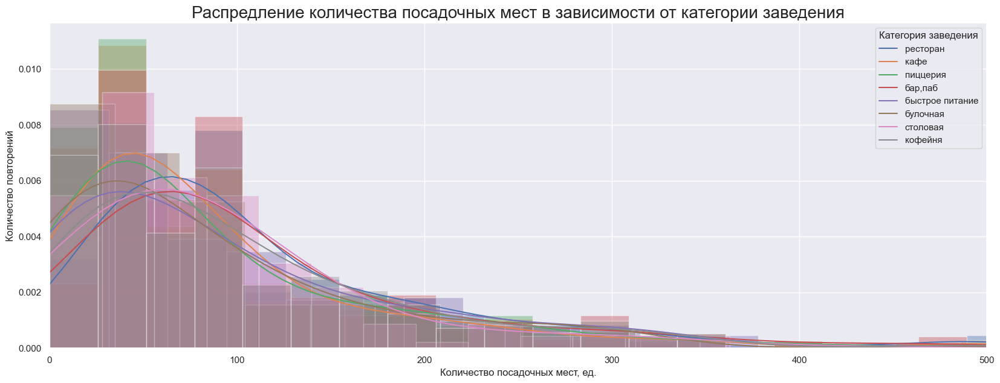

In [14]:
#задаем размер графика
plt.figure(figsize=(20,7))

#создаем цикл, в котором строим график распределения значений по каждой категории заведений
for i, category in enumerate(data_seats['category'].unique()):
    sns.distplot(data_seats[data_seats['category'] == category]['seats'])

#зададим наименование графика и подписи осям
plt.title('Распредление количества посадочных мест в зависимости от категории заведения', fontsize=20)
plt.xlabel('Количество посадочных мест, ед.')
plt.ylabel('Количество повторений')

#установим лимит по количеству посадочных мест не больше 500
plt.xlim(0, 500) 

#выведем легенду
plt.legend(data_seats['category'].unique(), title='Категория заведения');

Видим, что медианные значения сосредоточены в районе 50-80 посадочных мест.

Построим также столбчатую диаграмму с отображение среднего количества посадочных мест:

In [15]:
#построим столбчатую диаграмму количества посадочных мест в зависимости от категории
fig = px.bar(
    data_seats.groupby( #сгруппируем датафрейм по категории заведений
        'category'
    ).agg(
        'median' #посчитаем медианное количество посадочных мест 
    )[
        'seats'
    ].reset_index(
    ).sort_values(by='seats'), #отсортируем полученные значения по возрастанию
    x='seats', #оси абсцисс передадим значения кол-ва посадочных мест
    y='category', #оси ординат - наименования категорий заведений
    text='seats' #добавим подписи кол-ва посадочных мест
)

#дадим название графику, а также подписи осям
fig.update_layout(
    title='Количество посадочных мест в зависимости от категории заведения',
    xaxis_title='Количество посадочных мест. шт.',
    yaxis_title='Категория заведения'
)

**Анализ соотношения сетевых и несетевых заведений в датасете:**
<a id="chain"></a> 

Посмотрим какие заведения и сколько их относится к сетевым:

In [16]:
#создадим датафрейм, который отсортируем по тем заведениям, у которых признак 'chain' == True
chain_true = pd.DataFrame(data[data['chain']==True]['name'].unique()).rename(columns={0:'name'})

#выведем количество заведений, имеющих признак chain==True
chain_true.shape[0]

747

Количество таких заведенй равно 747. Предварительно в описании данных было указано, что могут встречаться ошибки для мелких сетей. Поэтому выведем датасет, в котором отобразим заведения, которых 2 и больше в нашем исходном датасете:

In [17]:
#выведем названия всех заведений, названия которых встречаются в исходном датасете 2 и более раз
name_more_2 = data['name'].value_counts().reset_index().rename(columns={'index':'name', 'name':'number'}).query('number>1')

#выведем кол-во заведений, который повтряются 2 и болле раз
name_more_2.shape[0]

752

In [18]:
name_more_2

,name,number
0,кафе,188
1,шоколадница,120
2,домино'с пицца,77
3,додо пицца,74
4,one price coffee,72
...,...,...
747,ссср,2
748,дымок,2
749,espresso bar,2
750,музейное кафе,2


Получается таких заведений больше, чем изначально определено признаком "chain" и составляет 752 ед.

Выведем список заведений, которые имеют признак chain=True, но сами встречаются в датасете только один раз:

In [19]:
#выведем список заведений, которые имеют признак chain=True, но встречаются в исходном датафрейме только 1 раз
not_chain = pd.DataFrame(chain_true[chain_true['name'].isin(name_more_2['name'])==False]['name']).reset_index(drop=True)

#выведем полученный датафрейм
not_chain

,name
0,крепери
1,vintage
2,halal food
3,wаурма
4,в своей тарелке
5,китчен
6,tasty thai
7,чао-пицца
8,суши wok
9,bigсуши


Получается таких заведений 58 ед. Удалим их для анализа долей сетевых и несетевых заведений, т.к. мы точно не можем знать являются они все же сетевыми или нет, а относить их к чему-то одному мы не можем, т.к. не уверены. При этом, удалив их мы потеряем меньше 1% данных, что допустимо:

In [20]:
#отфильтруем датафрейм, убрав из него строки с заведениями, которые содержатся в not_chain
data_chain = data[-data['name'].isin(not_chain['name'])]

#посмотрим сколько осталось строк в полученном датасете
data_chain.shape[0]

8343

Теперь сравним соотношение сетевых и несетевых заведений в полученном датасете:

In [21]:
#сгруппируем данные по количеству сетевых и несетевых заведений
data_chain_grouped = pd.DataFrame(
    data_chain.groupby('chain')['chain'].count()
).rename(
    columns={'chain':'number'} #зададим корректное наименование столбцов
).reset_index() #перезапишем индексы

#построим круговую диаграмму с отображением доли сетевых и несетевых клиентов
fig = go.Figure(data=[go.Pie(labels=data_chain_grouped['chain'], # указываем значения, которые появятся на метках сегментов
                           values=data_chain_grouped['number'])] # указываем данные, которые отобразятся на графике
               )
fig.update_layout(title='Доля сетевых и несетевых заведений', # указываем заголовок графика
                  width=400, # указываем размеры графика
                  height=400,
                  annotations=[dict(x=1.4, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Несети и сети',
                                    showarrow=False)]
                 )

На графике наглядно видно, что доля несетевых заведений превалирует над сетевыми.

**Анализ категорий заведений, которые чаще являются сетевыми:**
<a id="chain_category"></a> 

In [22]:
#создадим сводную таблицу, в коорой выведем количество сетевых не сетевыхзаведений для каждой категории
pivot_data_chain = data_chain.pivot_table(
    index='category',
    columns='chain',
    values='name',
    aggfunc='count',
    margins='All' #выведем подитоги
).drop(
    ['All'], axis=0 #удалим строчный подитог, т.к. он не понадобится для расчетов
).reset_index()

#добавим в полученную сводную таблицу столбцы с долей сетевых и несетевых заведений для каждой категории
pivot_data_chain['part_true_%'] = round(pivot_data_chain[True] / pivot_data_chain['All'] * 100, 0)
pivot_data_chain['part_false_%'] = 100 - pivot_data_chain['part_true_%']

#отсортируем данные по возрастанию доли сетей в каждой категории
pivot_data_chain = pivot_data_chain.sort_values(by='part_true_%')

#выведем полученную таблицу
pivot_data_chain

chain,category,False,True,All,part_true_%,part_false_%
0,"бар,паб",596,163,759,21.0,79.0
7,столовая,227,85,312,27.0,73.0
3,кафе,1597,749,2346,32.0,68.0
6,ресторан,1313,720,2033,35.0,65.0
2,быстрое питание,371,231,602,38.0,62.0
4,кофейня,693,715,1408,51.0,49.0
5,пиццерия,303,325,628,52.0,48.0
1,булочная,99,156,255,61.0,39.0


Получается, что сетевыми чаще являются такие небольшие заведения, как булочные, пиццерии и кофейни.

Визуализируем полученные данные:

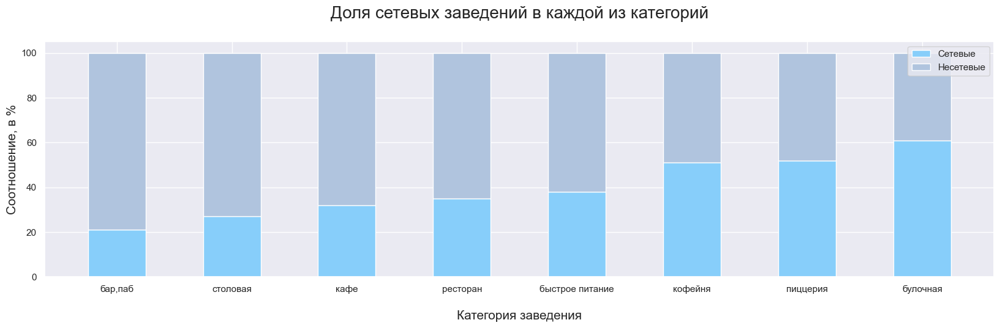

In [23]:
#построим столбчатую диаграмму с накоплением
fig, ax = plt.subplots()

#размещаем данные по сетевым заведениям
ax.bar(
    pivot_data_chain['category'], #по оси x будут расположены категории заведений
    pivot_data_chain['part_true_%'], #по оси y доля сетевых заведений
    label='Сетевые', #присваиваем название для отображения в легенде
    color='lightskyblue', #устанавливаем цвет
    width=0.5 #устанавливаем ширину столбцов
)

#на том же графике размещаем данные по несетевым заведениям
ax.bar(
    pivot_data_chain['category'], #по оси x будут расположены категории заведений
    pivot_data_chain['part_false_%'], #по оси y доля несетевых заведений
    bottom= pivot_data_chain['part_true_%'], #указываем, что данные будут расположены над сетевыми
    label='Несетевые', #присваиваем название для отображения в легенде
    color='lightsteelblue', #устанавливаем цвет
    width=0.5 #устанавливаем ширину столбцов
)

#задаем название графику и подписи осям
ax.set_title('Доля сетевых заведений в каждой из категорий\n', fontsize=20)
ax.set_xlabel('\nКатегория заведения', fontsize=15)
ax.set_ylabel('Соотношение, в %', fontsize=15)

#отображаем легенду
ax.legend()
#задаем размеры графика
fig.set_figheight(5) # высота 
fig.set_figwidth(20); # ширина

На графике наглядно представлено, что больше всего сетевых заведений среди булочных, пиццерий и кофеен, а меньше всего - среди бар/пабов, столовых и кафе.

Скорее всего это обусловлено финансовой моделью таких заведений, т.к. им требуется узнаваемость и большой поток людей на небольшие заказы. В то время как для кафе, ресторанов, столовых и баров - это не так важно. Скорее всего, средний чек для них тоже выше, чем для кофеен, пиццерий и булочных. Но это мы проверим дальше.

**Топ-15 популярных сетей в Москве:**
<a id="top_15"></a> 

In [24]:
#сгруппируем исходный датасет по названиям сетевых заведений
top_15_chain = data[data['chain']==True][
    ['name', 'category']
].groupby(
    ['name', 'category']
).agg(
    {'name':'count'}
).rename(
    columns={'name':'number'}
).sort_values(
    by='number',
    ascending=False
).head(15).reset_index()

#выведем полученный датасет
top_15_chain

,name,category,number
0,шоколадница,кофейня,119
1,домино'с пицца,пиццерия,76
2,додо пицца,пиццерия,74
3,one price coffee,кофейня,71
4,яндекс лавка,ресторан,69
5,cofix,кофейня,65
6,prime,ресторан,49
7,кофепорт,кофейня,42
8,кулинарная лавка братьев караваевых,кафе,39
9,теремок,ресторан,36


Отобразим полученные данные на графике:

In [25]:
#построим столбчатую диаграмму
fig = px.bar(
    top_15_chain,
    x='name', #оси абсцисс передадим наименования сетевых заведений
    y='number', #оси ординат - количество сетевых заведений
    text='category', #подпишем наименование категорий на графике
    color= 'category' #распределим категории по цветам
)

#дадим название графику, а также подписи осям
fig.update_layout(
    title='15 наиболее популярных сетевых заведений в разбивке по категориям',
    xaxis_title='Наименование заведения',
    yaxis_title='Количество заведений. шт.'
)

fig.show()

Среди топовых сетевых заведений наиболее распространены кофейни (6 шт.). Количество заведений из категорий рестораны и кафе - поровну (по 3 шт.), затем 2 пицерии и 1 булочная.

Все сети известны и наслуху и всех их объединяет наличие готовой еды или очень быстрое ее приготовление. В такие заведения посетители заходят очень часто по утрам перед работой, чтобы взять кофе, или на обеденный перерыв, а также просто, когда нужно очень быстро поесть.

Единственное из всего списка выбивается "Чайхана" - это просто довольно распространенное кафе и Яндекс-лавка - т.к. это онлайн доставка продуктов, готовой еды и товаров для дома.

**Анализ общего количества заведений и количества заведений каждой категории в разрезе по административным округам:**
<a id="district"></a> 

Рассмотрим в каких административных районах Москвы расположены исследуемые заведения:

In [26]:
#выведем уникальные нименования административных окргуов Москвы в рассматриваемом датасете
pd.Series(data['district'].unique())

0            Северный административный округ
1    Северо-Восточный административный округ
2     Северо-Западный административный округ
3            Западный административный округ
4         Центральный административный округ
5           Восточный административный округ
6       Юго-Восточный административный округ
7               Южный административный округ
8        Юго-Западный административный округ
dtype: object

В 9 из 12 имеющихся в Москве административных округов расположены рассматриваемые нами заведения.

In [27]:
#создадим сводную таблицу в разрезе административных округов и категорий заведений
district_category = data.pivot_table(
    index='district',
    columns='category',
    aggfunc='count',
    values='name',
    margins='All' #выведем подитоги
).drop(
    ['All'], axis=0 #удалим подитоговую строку, т.к. она нам не понадобится для анализа
).sort_values(by='All', ascending=False) #отсортируем полученные значения по убыванию значений в столбце с подитогами

#выведем полученную ктаблицу
district_category

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,All
district,,,,,,,,,
Центральный административный округ,364,50,87,464,428,113,670,66,2242
Северный административный округ,68,39,58,234,193,77,188,41,898
Южный административный округ,68,25,85,264,131,73,202,44,892
Северо-Восточный административный округ,62,28,82,269,159,68,182,40,890
Западный административный округ,50,37,62,238,150,71,218,24,850
Восточный административный округ,53,25,71,272,105,72,160,40,798
Юго-Восточный административный округ,38,13,67,282,89,55,145,25,714
Юго-Западный административный округ,38,27,61,238,96,64,168,17,709
Северо-Западный административный округ,23,12,30,115,62,40,109,18,409


Проиллюстрируем полученные данные на тихмэпе:

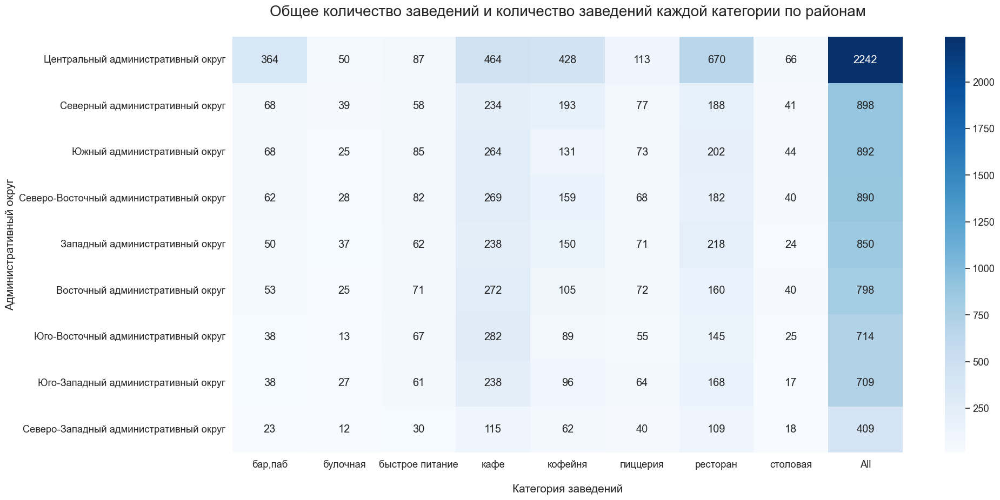

In [28]:
#зададим размер графика
plt.figure(figsize=(20, 10))
sns.set(font_scale=1.2) #заздаим размер шрифта для всех подписей

#построим хитмэп
sns.heatmap(
    district_category,
    annot=True,
    fmt='d',
    cmap='Blues') #зададим стиль

#зададим наименования заголовка и подписи осей графика, а также размер шрифта
plt.title('Общее количество заведений и количество заведений каждой категории по районам\n', fontsize=20)
plt.xlabel('\nКатегория заведений', fontsize=15)
plt.ylabel('Административный округ', fontsize=15);

Как и положено, в центре сосредоточено больше всего заведений общественного питания, причем с отрывом в 2 и более раза в отличе от других округов. В остальных районах количество заведений примерно одинаковое - в пределах 700-900 ед., за исключением Сереверо-Западного округа - в этом районе наблюдеается сильный отрыв от остальных - всего 409 заведений.

Стоит отметить, что в ЦАО в отличие от других округов очень много заведений категории бар/паб и ресторанов.

По всем округам можно отметить, что наиболее  распрорастрены категории заведений кафе и рестораны, а также кофейни.

**Анализ распределения средних рейтингов по категориям заведений:**
<a id="rating"></a> 

Визуализируем распределение средних рейтингов для каждой категории заведений:

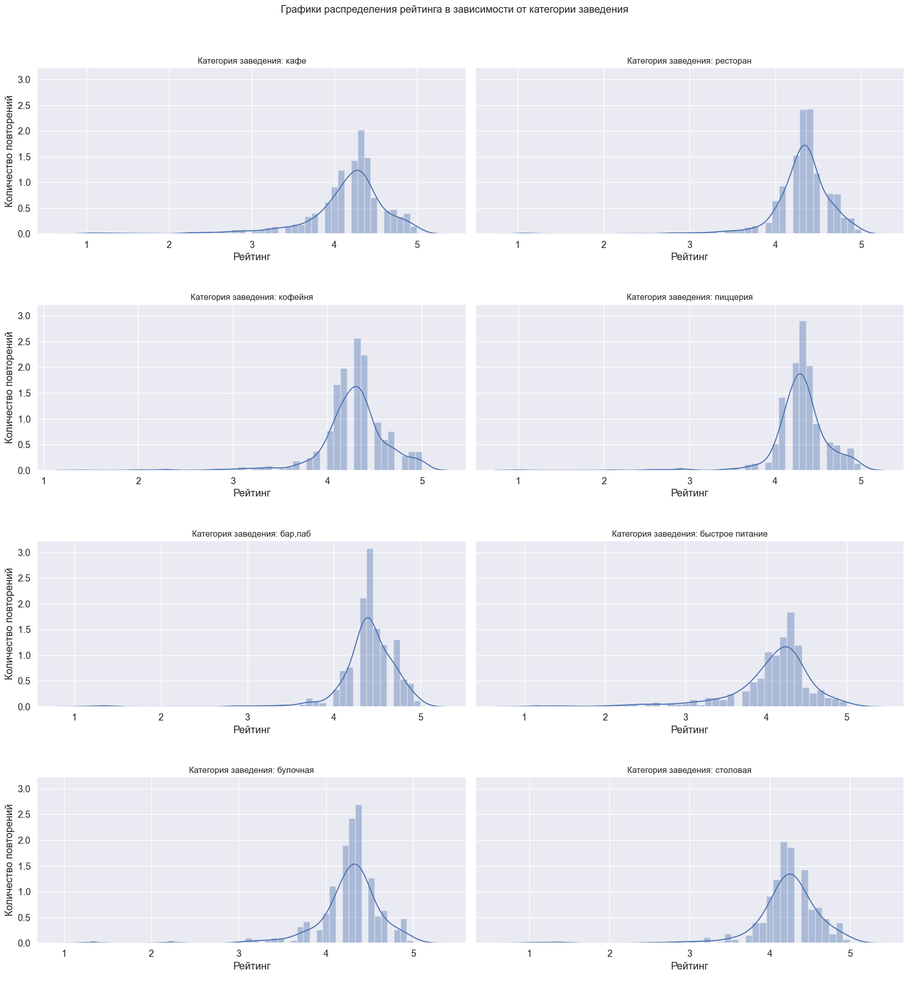

In [29]:
#зададим сетку из 4х2 подграфиков, которая будет содеражть наши распредления
fig, axes = plt.subplots(4, 2, sharey=True)

#зададим размер одного подграфика
sns.set(rc={'figure.figsize': (18, 20)})

#даем название графика
fig.suptitle('Графики распределения рейтинга в зависимости от категории заведения\n\n\n\n')

#перебираем пары «порядковый номер-элемент» из уникальных значений category
for i, category in enumerate(data['category'].unique()):
    ax = axes[i // 2, i % 2] #определяем координаты расположения графика в сетке
    sns.distplot(data[data['category'] == category]['rating'], ax=ax)
    ax.set(title=f'Категория заведения: {category}',
          xlabel='Рейтинг\n\n',
          ylabel='Количество повторений')
    
#равномерно размещаем графики 
plt.tight_layout()

#выводим полученные графики на экран
plt.show()

Из полученных графиков видно, что средние рейтинги каждой категории несильно отличаются друг от друга и расположены где-то в районе 4,3 балла из 5 максимальных. Подтвердим наблюдаемые значения цифрами:

In [30]:
#сгруппируем данные по категориям и выведем для каждой медианные значения рейтинга заведений
data.groupby('category', as_index=False)['rating'].agg('median')

,category,rating
0,"бар,паб",4.4
1,булочная,4.3
2,быстрое питание,4.2
3,кафе,4.2
4,кофейня,4.3
5,пиццерия,4.3
6,ресторан,4.3
7,столовая,4.3


Полученные значения соотвествуют наблюдаемым на графиках.

Т.е. можно сделать вывод, что, как правило, рейтинг относительно одинаковый для всех категорий заведений.

Также для наглядности отобразим полученные данные на одном графике:

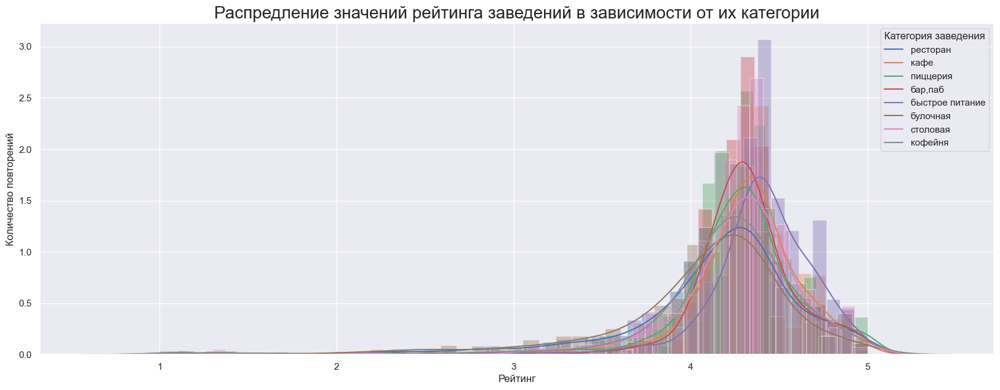

In [31]:
#задаем размер графика
plt.figure(figsize=(20,7))

#создаем цикл, в котором строим график распределения значений по каждой категории заведений
for i, category in enumerate(data['category'].unique()):
    sns.distplot(data[data['category'] == category]['rating'])

#зададим наименование графика и подписи осям
plt.title('Распредление значений рейтинга заведений в зависимости от их категории', fontsize=20)
plt.xlabel('Рейтинг')
plt.ylabel('Количество повторений')

#выведем легенду
plt.legend(data_seats['category'].unique(), title='Категория заведения');

Видим, что медианные значения сосредоточены в районе рейтинга со значением 4.3.

Построим также столбчатую диаграмму с отображение среднего рейтинга для каждой категории заведений:

In [32]:
#построим столбчатую диаграмму по рейтингу в зависимости от категории заведения
fig = px.bar(
    data_seats.groupby( #сгруппируем датафрейм по категории заведений
        'category'
    ).agg(
        'median' #посчитаем медианное значение рейтинга
    )[
        'rating'
    ].reset_index(
    ).sort_values(by='rating'), #отсортируем полученные значения по возрастанию
    x='rating', #оси абсцисс передадим значения рэйтинга
    y='category', #оси ординат - наименования категорий заведений
    text='rating' #добавим подписи значений рейтинга
)

#дадим название графику, а также подписи осям
fig.update_layout(
    title='Средние значения рейтинга заведений в зависимости от их категории',
    xaxis_title='Рэйтинг',
    yaxis_title='Категория заведения'
)

**Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района:**
<a id="map"></a>

In [33]:
#сперва создадим файл, в котором посчитаем медианный рейтинг заведений для каждого адм. округа Москвы
district_rating = data.groupby('district', as_index=False)['rating'].agg('median')
district_rating

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [34]:
#для построения хороплета сперва нужно выгрузить координаты границ административным округов Москвы
#поэтому подключаем модуль для работы с JSON-форматом
import json

#создадим переменную с расположением адреса, в котором находится выгружаемый файл на локальном компьюетере
path = 'C://Users//vladi//Downloads//'

#читаем файл и сохраняем в переменной
try:
    with open(path + 'admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)
except:
    with open('/datasets/admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)

In [35]:
#импортируем карту, хороплет и маркеры
from folium import Map, Choropleth, Marker

#moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

#создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=district_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.5,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

#выводим карту
m

Видно, что самый высокий рейтинг сосредоточен среди заведений, расположенных в ЦФО - 4.4.

Заведения с самым низким рейтингом расположены в СВАО и ЮВАО - 4.2.

В остальных районах - рейтинг равен 4.3.

**На этой же карте отобразим все заведения датасета на карте с помощью кластеров:**
<a id="cluster"></a>

In [36]:
# импортируем кластер
from folium.plugins import MarkerCluster

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

**Анализ топ-15 улиц по количеству заведений:**
<a id="street"></a>

In [37]:
#выведем список топ-15 улиц, на которых расположено больше всего заведений
top_15_street = data['street'].value_counts(
).reset_index( #перезапишем индексы
).rename( #зададим корректные наименования колонкам
    columns={
        'index':'street',
        'street':'number'}
).head(15) #сохраним только первые 15 значений

#выведем полученную таблицу
top_15_street

,street,number
0,проспект Мира,183
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


Посмотрим информацию о заведениях, расположенных на этих улицах (их количество и категории):

In [38]:
#сформируем датасет, в котором отобразим наименования кафе и категорий, которые расположены на улицах, определенных выше
df_top_15_street = data[
    data['street'].isin(top_15_street['street'])
][['name', 'category', 'street']
 ].reset_index(drop=True)

#преобразуем полученную таблицу, сгруппировав данные по улицам и категориям заведений и посчитав их колчиство
df_top_15_street = df_top_15_street.pivot_table(
    index='street',
    columns='category',
    values='name',
    aggfunc='count',
    margins='All' #выводим подитоги
).fillna( #пропуски заполняем нулями
    0
).drop( #удаляем строку с подитоговым значением
    ['All'], axis=0
).sort_values( #соритруем данные по колонке с итогами в порядке убывания
    by='All',
    ascending=False
).astype('int') #приводим все к целочисленному значению

#выведем полученную таблицу
df_top_15_street

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,All
street,,,,,,,,,
проспект Мира,11,4,21,53,36,11,45,2,183
Профсоюзная улица,6,4,15,35,18,15,26,3,122
проспект Вернадского,7,1,12,25,16,12,33,2,108
Ленинский проспект,10,3,2,26,23,5,33,5,107
Ленинградский проспект,15,4,2,12,25,9,25,3,95
Дмитровское шоссе,6,2,10,23,11,8,24,4,88
Каширское шоссе,2,0,10,20,16,5,19,5,77
Варшавское шоссе,6,0,7,18,14,4,20,7,76
Ленинградское шоссе,5,2,5,13,13,3,26,3,70


Отобразим полученные данные графически - построим график распределения количества заведений и их категорий по отобранным улицам:

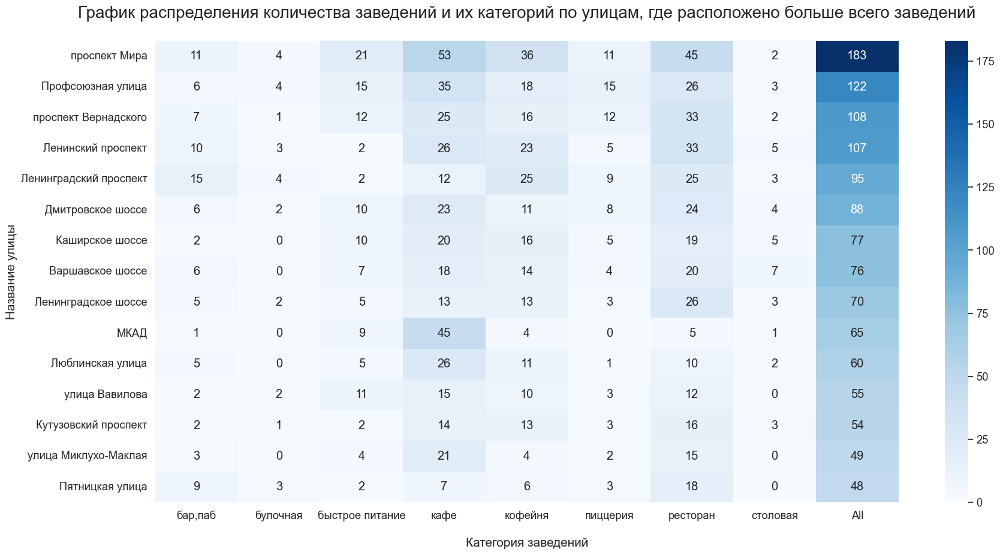

In [39]:
#зададим размер графика
plt.figure(figsize=(20, 10))
sns.set(font_scale=1.2) #заздаим размер шрифта для всех подписей

#построим хитмэп
sns.heatmap(
    df_top_15_street,
    annot=True,
    fmt='d',
    cmap='Blues') #зададим стиль

#зададим наименования заголовка и подписи осей графика, а также размер шрифта
plt.title('График распределения количества заведений и их категорий по улицам, где расположено больше всего заведений\n',
          fontsize=20)
plt.xlabel('\nКатегория заведений', fontsize=15)
plt.ylabel('Название улицы', fontsize=15);

Больше всего заведений расположено на улице проспект Мира, причем с приличным отрывом. Довольно много заведений расположено как на улицах, расположенных на севере Москвы (например, Ленинградский проспект и Дмитровское ш.), так и на юге (Каширское ш. и Варшавское ш.).

На Пятницкой улице расположено меньше всего заведений, хоть она и расположена в самом центре. Можно предположить, что количество заведений также зависит от длины улицы: чем она больше, тем больше заведений на ней может расположиться. Также это может зависеть от наличия пустых помещений для того, чтобы открыть заведение или же свободного земельного участка для постройки заведения.

Можно отметить, что больше всего на всех улицах расположены заведения из категории кафе, кофейня и ресторан.

**Проанализируем заведения, которые являются единственными объектами общепита на той или иной улице:**
<a id="street_one_obj"></a>

In [40]:
#сформируем датасет по количеству заведений на каждой улице
street_one_obj = data['street'].value_counts(
).reset_index( #перезапишем индексы
).rename( #переименуем колонки
    columns={
        'index':'street',
        'street':'number'
    }
)

In [41]:
#отфильтруем полученную таблицу по кол-ву заведений равное 1
street_one_obj = street_one_obj[street_one_obj['number']==1].reset_index(drop=True)
street_one_obj

,street,number
0,4-й Воробьёвский проезд,1
1,Липецкая улица (дублёр),1
2,улица Речников,1
3,проспект Лихачёва,1
4,Андреевский пешеходный мост,1
...,...,...
454,улица Маршала Соколовского,1
455,Малый Казённый переулок,1
456,улица Максимова,1
457,Басманный тупик,1


Всего 458 заведений (или 5% от всего количества заведений), которые являются единственными объектами общепита на различных 458 улицах.

Выведем более подробную информацию о них и проанализируем полученные данные:

In [42]:
#отфильтруем в общем датасета только те, улицы, на которых расположено по 1 заведению
one_obj = data[
    data['street'].isin(street_one_obj['street'])
][ #и выведем следующую информацию о таких заведениях
    ['name', 'category', 'address', 'district', 'rating', 'chain', 'is_24/7'] 
].reset_index(drop=True)

#выведем полученный датасет
one_obj

,name,category,address,district,rating,chain,is_24/7
0,дом обеда,столовая,"москва, улица бусиновская горка, 2",Северный административный округ,4.1,False,False
1,7/12,кафе,"москва, прибрежный проезд, 7",Северный административный округ,4.5,False,False
2,в парке вкуснее,кофейня,"москва, парк левобережный",Северный административный округ,4.3,True,False
3,coffeekaldi's,кофейня,"москва, угличская улица, 13, стр. 8",Северо-Восточный административный округ,4.1,True,False
4,чебуречная история,кофейня,"москва, ландшафтный заказник лианозовский",Северо-Восточный административный округ,4.9,True,False
...,...,...,...,...,...,...,...
454,мираж,ресторан,"москва, улица шкулёва, 2а",Юго-Восточный административный округ,4.7,False,False
455,wtfcoffee,кофейня,"москва, улица артюхиной, 14/8с1",Юго-Восточный административный округ,4.4,False,False
456,беседка,кафе,"москва, кузьминская улица, 10",Юго-Восточный административный округ,4.1,True,False
457,лагман хаус,кафе,"москва, новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,4.3,True,False


Посмотрим к каким категориям преимущественно относятся данные единичные объекты и сравним их с долями категорий заведений по всему датасету:

In [43]:
#создадим функцию, принимающую в качестве аргумента признак, по которому будем сравнивать основной датасет
#и датасет с заведениями, являющимися единственными на той или иной улице,
#и возвращую график сравнения этих долей
def plot_ratio(value): #передаем признак, по которому будем сравнивать датасеты
    #создаем переменную, в которой отобразим сгруппированный датасет с единственными объектами на той или иной улице
    #по заданному признаку
    one_object_grouped = one_obj.groupby( 
        value
    ).agg(
        'count' #считаем количество полученных значений
    )[
        'name'
    ].sort_values( #сортируем полученные значения по убыванию
        ascending=False
    ).reset_index(
    ).rename( #задаем корректные наименования полученному столбцу
        columns={'name':'count'}
    )
    #в полученную таблицу добавляем столбец с подсчетом доли каждого признака в общей сумме
    one_object_grouped['ratio_%'] = round(one_object_grouped['count'].div(one_object_grouped['count'].sum())*100, 0)
    #и добавляем столбец с признаком, что полученные значения из датасета с объектами,
    #являющимися единственными на той или иной улице
    one_object_grouped['dataset'] = 'one_obj'
    
    
    #создаем переменную, в которой отобразим сгруппированный датасет по всем заведениям по заданному признаку
    data_grouped = data.groupby(
        value
    ).agg( #считаем количество полученных значений
        'count'
    )[
        'name'
    ].sort_values(
        ascending=False #сортируем полученные значения по убыванию
    ).reset_index(
    ).rename( #задаем корректные наименования полученному столбцу
        columns={'name':'count'}
    )
    #в полученную таблицу добавляем столбец с подсчетом доли каждого признака в общей сумме
    data_grouped['ratio_%'] = round(data_grouped['count'].div(data_grouped['count'].sum())*100, 0)
    #и добавляем столбец с признаком, что полученные значения из датасета со всеми заведениями
    data_grouped['dataset'] = 'data' 
    
    #создадим переменную, в которой объединим полученные таблицы
    data_union = pd.concat(
    [one_object_grouped, data_grouped],
    axis=0 #указаываем, что таблицы будем объединять друг под другом
).reset_index( #перезапишем индексы
        drop=True
    )
    
    #построим график сравнения долей по кажой категории
    plt.figure(figsize=(15, 7))
    #строим столбчатый график средствами seaborn
    sns.barplot(
        x=value, #по оси х отложим признак, по которому хотим сравнить датасеты
        y='ratio_%', #по оси у - значения долей
        data=data_union,
        hue='dataset', #укажем, что отличем для графиков должно быть из какого датасета они
        palette=['indigo', 'mediumslateblue'] #задаем цвета столбцов
    )
    #формируем заголовок графика и подписи осей средствами matplotlib
    plt.title(f'Соотношение распределения долей заведений в общем датасете и датасете с единственными\
объектами на той или иной улице в зависимости от {value}')
    plt.xlabel('Наименование категории заведения')
    plt.ylabel('Доля заведений, %')
    #поворачиваем подписи значений по оси X на 45 градусов
    plt.xticks(rotation=45)
    #выбираем положение легенды и указываем размер шрифта
    plt.legend(loc='upper right', fontsize=10)
    #задаем стиль графика
    sns.set_style('darkgrid')
    #отображаем график на экране
    plt.show()            

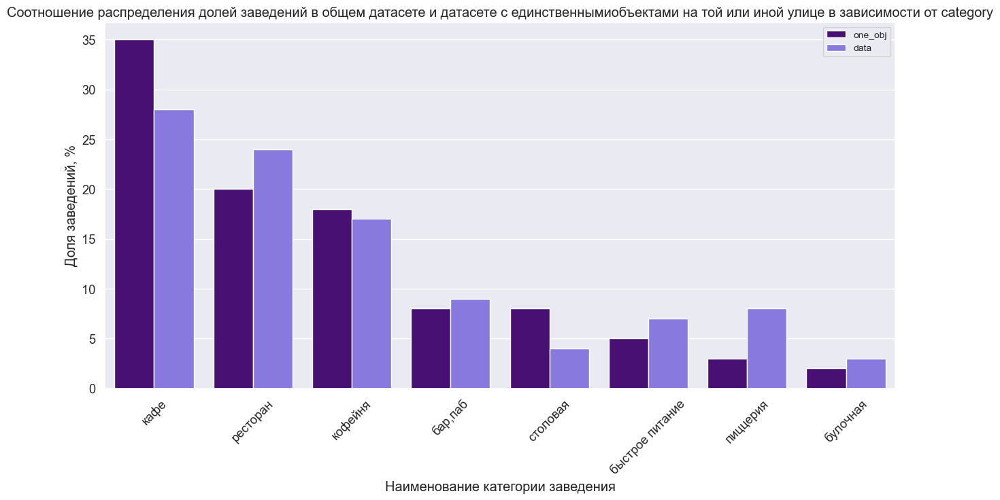

In [44]:
#построим график распредления долей всех заведений и заведений, которые являются единственными на той или иной улице,
#в зависимости от категории
plot_ratio('category')

Как видим отличие в соотвношении категорий в общем датасете и датасете для заведений, являющимися единственными на то или иной улице существенно не отличается.

Посмотрим аналогичное распределение соотношений по административным округам:

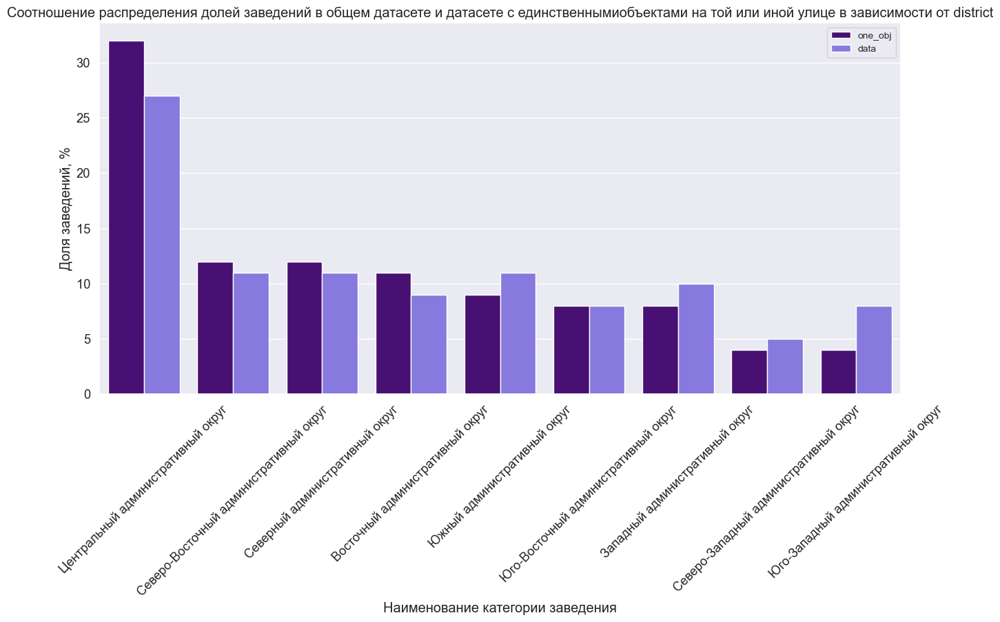

In [45]:
#построим график распредления долей всех заведений и заведений, которые являются единственными на той или иной улице,
#в зависимости от района
plot_ratio('district')

В разрезе округов распределение данных также соотвествует общей массе.

Посмотрим на график работы этих заведений:

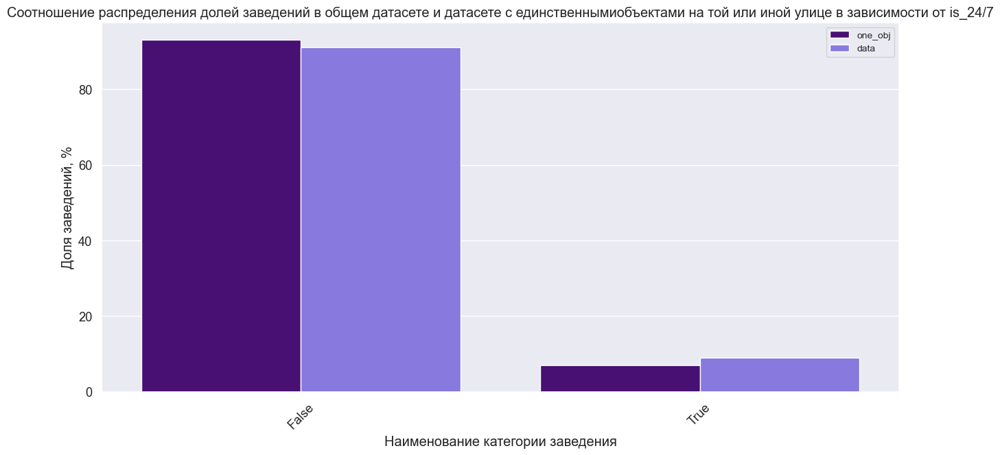

In [46]:
#построим график распредления долей всех заведений и заведений, которые являются единственными на той или иной улице,
#в зависимости от того работает заведение круглосуточно или нет
plot_ratio('is_24/7')

Большинство из них не работает круглосуточно и лишь малая часть 24/7, как и для общей массы заведений.

Проанализаируем также по признаку является ли заведение сетевым или нет:

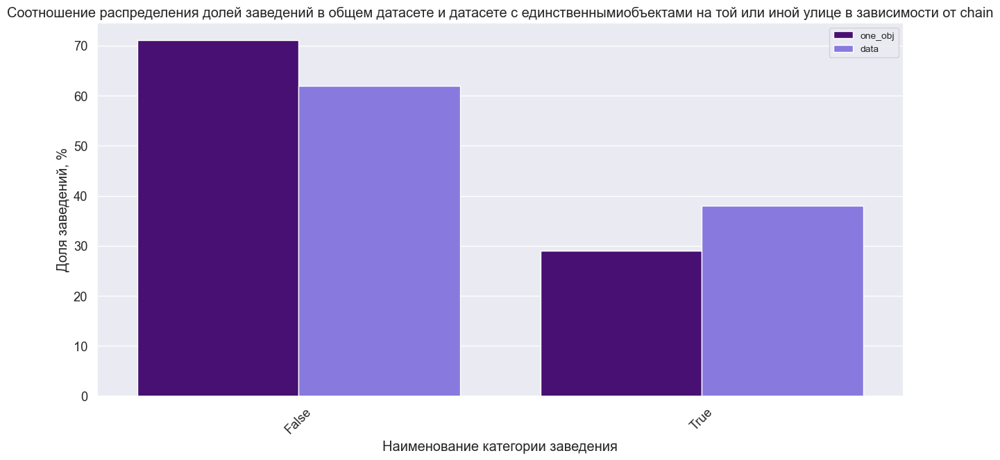

In [47]:
#построим график распредления долей всех заведений и заведений, которые являются единственными на той или иной улице,
#в зависимости от того является ли заведение сетевым или нет
plot_ratio('chain')

Можно все же отметить, что доля сетевых заведений, которые являются единственными на той или иной улице, меньше доли сетевых заведений всего датасета где-то на 10%.


Сравним средний рейтинг у данных заведений:

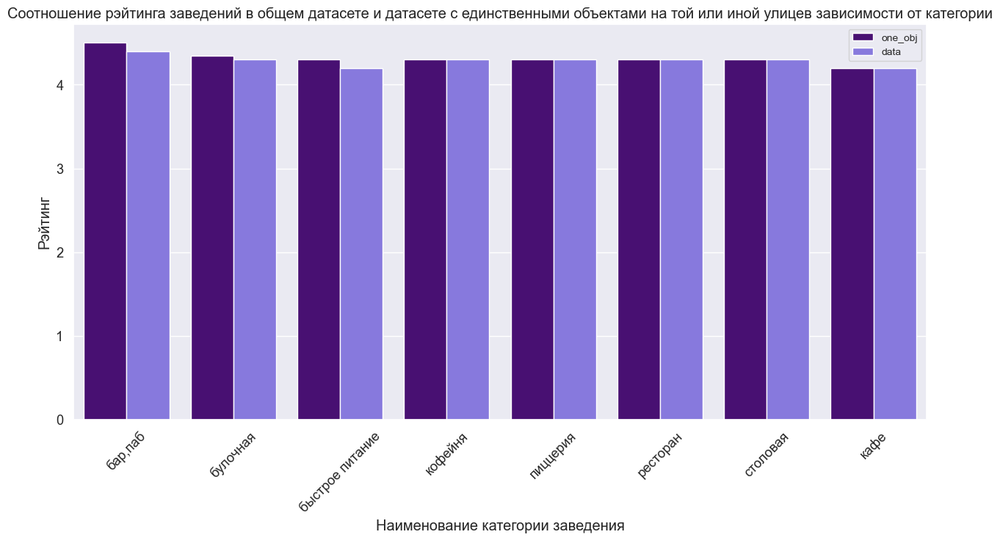

In [48]:
#создаем переменную, в которой отобразим сгруппированный датасет с единственными объектами на той или иной улице
#в зависимости от категории и выведем медианное значение рейтинга для каждой
one_object_grouped = one_obj.groupby(
    'category'
).agg(
    'median' #считаем медианное значение рейтинга
)[
    'rating'
].sort_values( #сортируем полученные значения по убыванию
    ascending=False
).reset_index()

#в полученную таблицу добавляем столбец с признаком, что полученные значения из датасета с объектами,
#являющимися единственными на той или иной улице
one_object_grouped['dataset'] = 'one_obj'
    
    
#создаем переменную, в которой отобразим сгруппированный датасет по всем заведениям по заданному признаку
data_grouped = data.groupby(
    'category'
).agg( #считаем медианное значение рейтинга
    'median'
)[
    'rating'
].sort_values(
    ascending=False #сортируем полученные значения по убыванию
).reset_index()
#в полученную таблицу добавляем столбец с признаком, что полученные значения из датасета со всеми заведениями
data_grouped['dataset'] = 'data' 
    
#создадим переменную, в которой объединим полученные таблицы
data_union = pd.concat(
    [one_object_grouped, data_grouped],
    axis=0 #указаываем, что таблицы будем объединять друг под другом
).reset_index( #перезапишем индексы
    drop=True
)
    
#построим график сравнения рейтинга заведений в зависимости от категории
plt.figure(figsize=(15, 7))
#строим столбчатый график средствами seaborn
sns.barplot(
    x='category', #по оси х - категории заведений
    y='rating', #по оси у - значения рэйтинга
    data=data_union,
    hue='dataset', #укажем, что отличем для графиков должно быть из какого датасета они
    palette=['indigo', 'mediumslateblue'] #задаем цвета столбцов
    )
#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Соотношение рэйтинга заведений в общем датасете и датасете с единственными объектами на той или иной улице\
в зависимости от категории')
plt.xlabel('Наименование категории заведения')
plt.ylabel('Рэйтинг')
#поворачиваем подписи значений по оси X на 45 градусов
plt.xticks(rotation=45)
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='upper right', fontsize=10)
#задаем стиль графика
sns.set_style('darkgrid')
#отображаем график на экране
plt.show()   

Медианные значения рейтинга заведений, являющимися единственными на той или иной улице, также коррелирует с рейтингом заведений общей массы в разрезе категорий.

**В целом можно сказать, что общая картина для данных заведений соответствует метрикам для заведений всего датасета.**

**Проанализируем как удалённость от центра влияет на цены в заведениях.**
<a id="middle_avg_bill"></a>

Значения средних чеков заведений хранятся в столбце middle_avg_bill, которые взяты из столбца avg_bill, начинающихся с подстроки «Средний счёт», при этом:
- если в строке столбца avg_bill указан ценовой диапазон из двух значений, в столбец middle_avg_bill войдёт медиана этих двух значений;
- если в строке указано одно число — цена без диапазона, то в столбец войдёт это число;
- если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.

Посчитаем медиану этого столбца для каждого района:

In [49]:
#сгруппируем датасет по административным округам и посчитаем средний чек для каждого
district_avg_bill = data.groupby('district').agg({'middle_avg_bill':'median'})['middle_avg_bill'].reset_index()

#выведем полученную таблицу
district_avg_bill

,district,middle_avg_bill
0,Восточный административный округ,575.0
1,Западный административный округ,1000.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,700.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,450.0
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


На основе полученных значений построим фоновую картограмму (хороплет):

In [50]:
#создаём карту Москвы
m_for_bill = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=district_avg_bill, #данные берем из сформированной таблицы
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='PuRd',
    fill_opacity=0.5,
    legend_name='Средний чек заведений по районам',
).add_to(m_for_bill)

#выводим карту
m_for_bill

Самые дорогие заведения расположены в центре и на западе (средний чек около 1 тыс. руб.), а вот самые недорогие - в СВАО, ЮВАО и ЮАО (средний чек около 450-500 руб.), т.е., чем дальше от центра, тем цены ниже.

Интересно, что как раз в СВАО самый высокий рейтинг у заведений среди других районов Москвы, а также там расположено небольшое количество заведений, относительно других.

**Исследуем круглосуточные заведения и их зависимость от расположения и категории заведения:**
<a id="24/7"></a>

In [51]:
#построим сводную таблицу
round_the_clock = data.pivot_table(
    index=['district', 'is_24/7'], #сгруппируем данные по признаку круглусоточное заведение или нет, а также по районам
    columns='category', #в разрезе категорий заведений
    values='name',
    aggfunc='count', #посчитаем количество в каждой подгруппе
    margins='All'
).fillna( #пустые значения заполним нулями
    0
).astype( #переведем полученные данные в целочисленные значения
    'int'
).drop(
    ['All'], axis=0
).sort_values( #отсортируем значения столбца с подитогами по убыванию
    by='All',
    ascending=False
).reset_index()

#переведем столбец с районами в индексы
round_the_clock.set_index('district', inplace=True)

#выведем полученную таблицу
round_the_clock

category,is_24/7,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,All
district,,,,,,,,,,
Центральный административный округ,False,335,49,73,434,402,111,644,63,2111
Северный административный округ,False,64,34,44,206,188,75,177,39,827
Южный административный округ,False,64,22,61,238,130,69,189,44,817
Северо-Восточный административный округ,False,58,24,65,238,156,65,171,38,815
Западный административный округ,False,45,37,44,213,141,69,206,23,778
Восточный административный округ,False,52,19,50,239,100,64,139,38,701
Юго-Западный административный округ,False,38,26,41,204,89,64,158,16,636
Юго-Восточный административный округ,False,33,12,52,234,88,46,132,24,621
Северо-Западный административный округ,False,23,9,23,103,60,39,91,18,366


Отобразим полученные данные графически.

Сперва посмотрим долю сетевых и несетевых заведений:

In [52]:
#построим круговую диаграмму с отображением долей круглосуточно работающих заведений и нет
fig = go.Figure(data=[go.Pie(labels=round_the_clock['is_24/7'], # указываем значения, которые появятся на метках сегментов
                           values=round_the_clock['All'])] # указываем данные, которые отобразятся на графике
               )
fig.update_layout(title='Отношение круглосуточно работающих заведений с некруглосуточными', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=500,
                  annotations=[dict(x=1.15, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Круглосуточно',
                                    showarrow=False)]
                 )

Доля круглосуточно работающих заведений составляет всего почти 9%, все остальные заведения работают в иных режимах.
 
Теперь посмотрим на взаимосвязь круглосуточной работы заведений с их расположением и категорией:

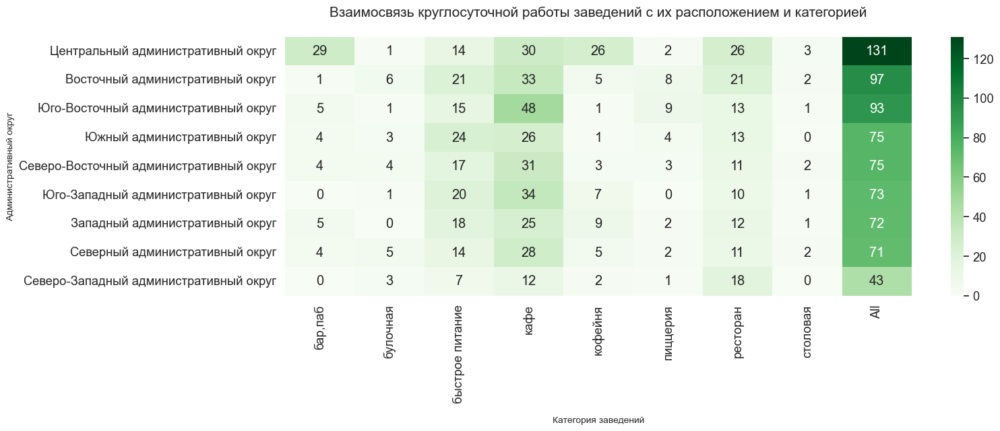

In [53]:
#сформируем 2 подтаблицы: одну с круглосуточными заведениями, другую - с остальными
true_rtc = round_the_clock[round_the_clock['is_24/7']==True].drop(['is_24/7'], axis=1)
false_rtc = round_the_clock[round_the_clock['is_24/7']==False].drop(['is_24/7'], axis=1)

#переходим к спотроению графиков
#задаем размер графика
plt.figure(figsize=(15, 5))

#строим хитмэп по данным с круглосуточными заведениями
sns.heatmap(
    true_rtc,
    annot=True,
    fmt='d',
    cmap='Greens'
) 
#зададим наименования заголовка и подписи осей графика, а также размер шрифта
plt.title('Взаимосвязь круглосуточной работы заведений с их расположением и категорией\n', fontsize=15)
plt.xlabel('\nКатегория заведений', fontsize=10)
plt.ylabel('Административный округ', fontsize=10);

Видим, что больше всего круглосуточных заведений в ЦАО, из них наибольшее значение относится к категории кафе. Пабов и баров в ЦАО на 1 заведение меньше, чем кафе, при в остальных районах Москвы они почти отсутствуют.

Больше всего круглосуточных кафе расположено в ЮВАО, а меньше всего в СЗАО.

Стоит отметить также, что такие категории заведений как быстрое питание, кафе и рестораны имеют преимущество среди других категорий в каждом из административных округов.

Почти отсутстсвуют круглосуточные столовые, также очень мало круглосуточных булочных.

Рассмотрим взаимосвязь остальных заведений с их срасположением и категорией:

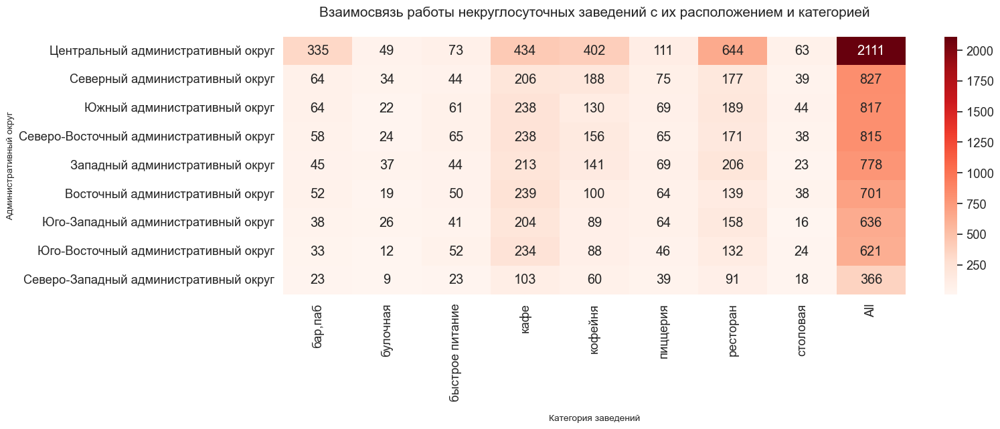

In [54]:
#задаем размер графика
plt.figure(figsize=(15, 5))

#строим хитмэп по данным остальных заведений
sns.heatmap(
    false_rtc,
    annot=True,
    fmt='d',
    cmap='Reds'
) 
#зададим наименования заголовка и подписи осей графика, а также размер шрифта
plt.title('Взаимосвязь работы некруглосуточных заведений с их расположением и категорией\n', fontsize=15)
plt.xlabel('\nКатегория заведений', fontsize=10)
plt.ylabel('Административный округ', fontsize=10);

Сразу можно отметить, что некруглосуточных заведений гораздо больше, что логично. В остальном в этих данных нет ничего примечательного, основные моменты мы уже отметили в подразделе ["Анализ общего количества заведений и количества заведений каждой категории в разрезе по административным округам"](#district)

**Анализ заведений с плохими рейтингами:**
<a id="low_rating"></a>

Из подраздела ["Анализа распределения средних рейтингов по категориям заведений"](#rating) мы выяснили, что средний рейтинг заведений равен 4.3.

In [55]:
#описание данных столбца с рэйтингом
data['rating'].describe()

count    8402.000000
mean        4.230017
std         0.470320
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

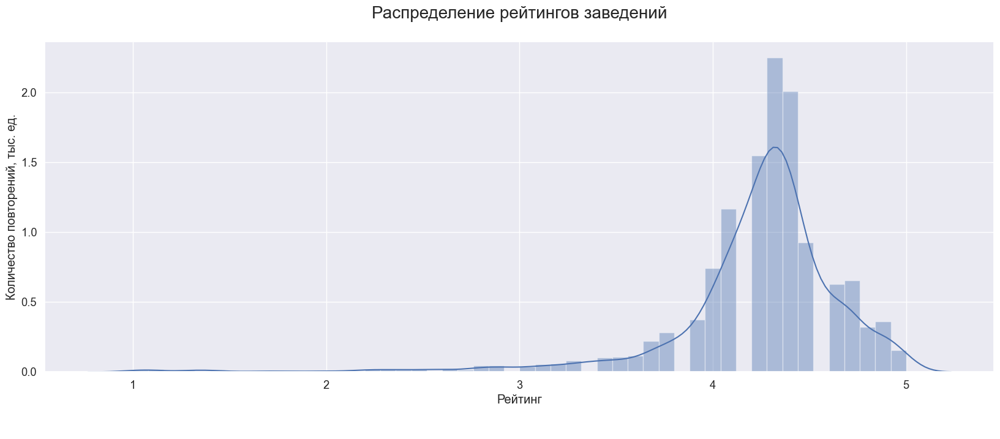

In [56]:
plt.figure(figsize=(20, 7)) #задаем размер графика
#строим гистограму с распределением значений рейтинга заведений
sns.distplot(data['rating'])
#зададим наименование графика, а также осей ординат
plt.title('Распределение рейтингов заведений\n', fontsize=20)
plt.xlabel('Рейтинг\n\n')
plt.ylabel('Количество повторений, тыс. ед.');

Возьмем за низкий рейтинг заведений 3.9 баллов и ниже и рассмотрим средние чеки таких заведений с низким рейтингом в разрезе районов, а также сравним их со средними чеками для всех заведений:

In [57]:
#создадим переменную, в которой отобразим все заведения, рейтинг которых ниже 3 баллов включительно, а также все данные о них
low_rating = data[data['rating']<4].reset_index()

#выведем полученную таблицу
low_rating

,index,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,28,mafe,кафе,"москва, мкад, 78-й километр, 14к1",Северный административный округ,"ежедневно, 10:00–19:00",55.893061,37.501319,3.8,средние,Средний счёт:400–600 ₽,500.0,NaN,False,NaN,МКАД,False
1,36,пекарня № 1 грузинская кухня,кафе,"москва, коровинское шоссе, 33а",Северный административный округ,"ежедневно, 10:00–22:00",55.882222,37.518057,3.9,NaN,NaN,NaN,NaN,False,21.0,Коровинское шоссе,False
2,37,халяль закусочная,кафе,"москва, коровинское шоссе, 46, стр. 5",Северный административный округ,"ежедневно, 08:00–23:00",55.888023,37.515443,3.9,NaN,NaN,NaN,NaN,False,NaN,Коровинское шоссе,False
3,40,кафе,кафе,"москва, ижорская улица, 18, стр. 1",Северный административный округ,NaN,55.895115,37.524902,3.7,NaN,NaN,NaN,NaN,False,NaN,Ижорская улица,False
4,42,варня кафе,быстрое питание,"москва, коровинское шоссе, 29, корп. 1",Северный административный округ,"ежедневно, 09:00–23:00",55.880010,37.520204,3.8,NaN,NaN,NaN,NaN,False,46.0,Коровинское шоссе,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1163,8387,кафе кенч,кафе,"москва, 1-я новокузьминская улица, 3",Юго-Восточный административный округ,"ежедневно, 11:00–00:00",55.716771,37.785316,2.8,NaN,NaN,NaN,NaN,False,45.0,1-я Новокузьминская улица,False
1164,8388,касабланка,кафе,"москва, большая косинская улица, 27",Восточный административный округ,пн-чт 08:00–17:00; пт 08:00–16:00,55.718514,37.857576,3.3,NaN,NaN,NaN,NaN,False,NaN,Большая Косинская улица,False
1165,8391,истира запрафка,кафе,"москва, юго-восточный административный округ, ...",Юго-Восточный административный округ,NaN,55.724686,37.710558,2.9,NaN,NaN,NaN,NaN,False,NaN,Юго-Восточный административный округ,False
1166,8399,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,False,150.0,Люблинская улица,True


Всего 1169 заведения с рейтингом ниже 4.

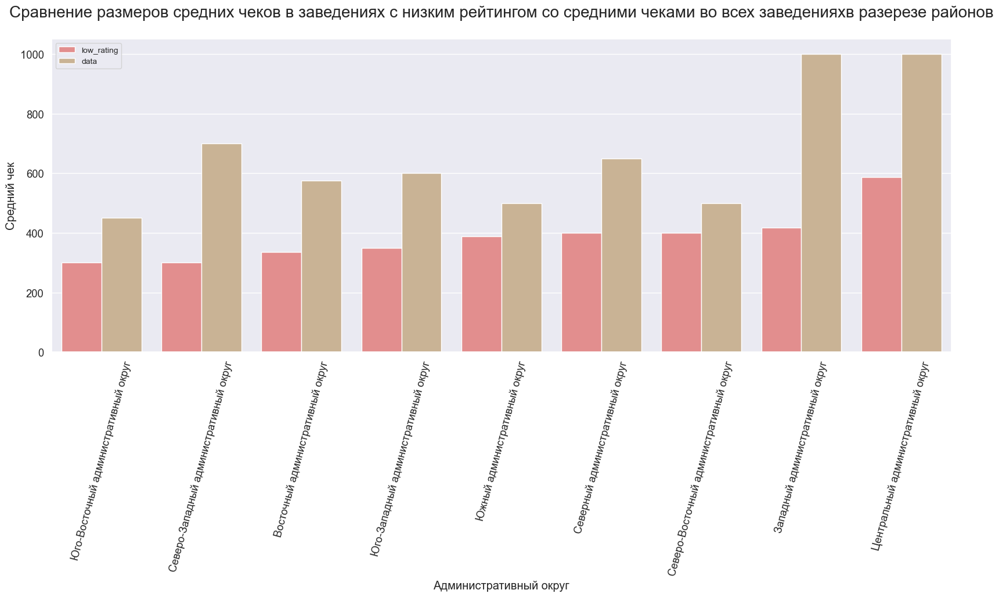

In [58]:
#сгруппируем полученную таблицу по административным округам и посчитаем средний чек для каждого
low_rating_avg_bill = low_rating.groupby('district').agg({'middle_avg_bill':'median'})['middle_avg_bill'].reset_index()
#добавим столбец, обозначающий, что данные для заведений с низким рейтингом
low_rating_avg_bill['dataset'] = 'low_rating'

#добавим в ранее сформированную таблицу столбец, обозначающий, что данные для всех заведений
district_avg_bill['dataset'] = 'data'

#создадим переменную, в которой объединим полученные таблицы
data_union = pd.concat(
    [low_rating_avg_bill, district_avg_bill],
    axis=0 #указаываем, что таблицы будем объединять друг под другом
).reset_index( #перезапишем индексы
    drop=True
).sort_values(by='middle_avg_bill')
    
#построим график сравнения средних чеков для заведений с низким рейтингом и всех остальных в разрезе районов
plt.figure(figsize=(20, 7)) #задаем размер графика
#строим столбчатый график средствами seaborn
sns.barplot(
    x='district', #по оси х - административный округ
    y='middle_avg_bill', #по оси у - значения среднего чека
    data=data_union,
    hue='dataset', #укажем, что отличем для графиков должно быть из какого датасета они
    palette=['lightcoral', 'tan'] #задаем цвета столбцов
    )
#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Сравнение размеров средних чеков в заведениях с низким рейтингом со средними чеками во всех заведениях\
в разерезе районов\n', fontsize=20)
plt.xlabel('Административный округ')
plt.ylabel('Средний чек')
#поворачиваем подписи значений по оси X на 75 градусов
plt.xticks(rotation=75)
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='upper left', fontsize=10)
#задаем стиль графика
sns.set_style('darkgrid')
#отображаем график на экране
plt.show()   

Средний чек в заведениях с низким рейтингом ниже для всех районов Москвы кроме ЮВАО. При этом очень большая разница средних чеков в ЦАО и ЗАО: заведения с низким рейтингом сильно отстают с размером среднего чека от всех заведений.

Рассмортрим средние чеки заведений с низким рейтингом в разрезе категорий:

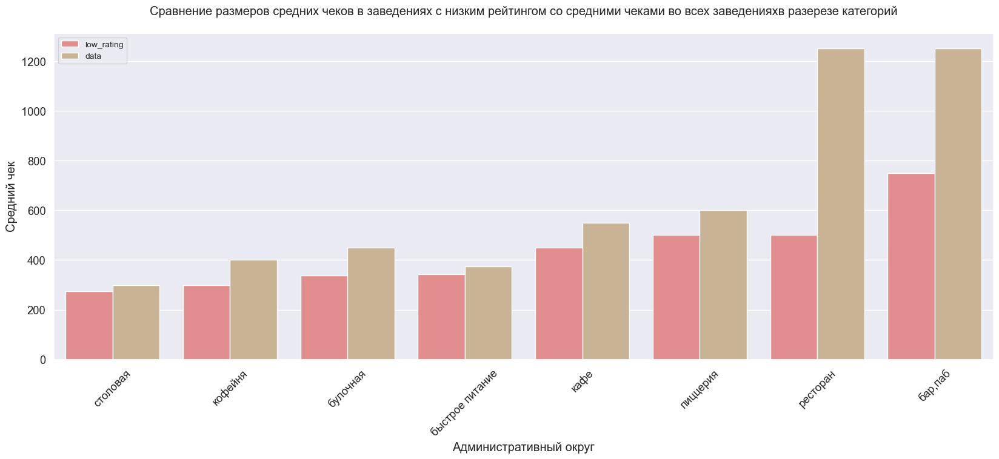

In [59]:
#сгруппируем ранее полученную таблицу заведений с низким рейтингом по их категориям и посчитаем средний чек для каждой
low_rating_avg_bill = low_rating.groupby('category').agg({'middle_avg_bill':'median'})['middle_avg_bill'].reset_index()
#добавим столбец, обозначающий, что данные для заведений с низким рейтингом
low_rating_avg_bill['dataset'] = 'low_rating'

#сгруппируем исходную таблицу с заведениями по их категориям и посчитаем средний чек для каждой
data_avg_bill = data.groupby('category').agg({'middle_avg_bill':'median'})['middle_avg_bill'].reset_index()
#добавим в ранее сформированную таблицу столбец, обозначающий, что данные для всех заведений
data_avg_bill['dataset'] = 'data'

#создадим переменную, в которой объединим полученные таблицы
data_union = pd.concat(
    [low_rating_avg_bill, data_avg_bill],
    axis=0 #указаываем, что таблицы будем объединять друг под другом
).reset_index( #перезапишем индексы
    drop=True
).sort_values(by='middle_avg_bill')
    
#построим график сравнения средних чеков для заведений с низким рейтингом и всех остальных в разрезе категорий
plt.figure(figsize=(20, 7))
#строим столбчатый график средствами seaborn
sns.barplot(
    x='category', #по оси х - категория заведения
    y='middle_avg_bill', #по оси у - значения среднего чека
    data=data_union,
    hue='dataset', #укажем, что отличем для графиков должно быть из какого датасета они
    palette=['lightcoral', 'tan'] #задаем цвета столбцов
    )
#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Сравнение размеров средних чеков в заведениях с низким рейтингом со средними чеками во всех заведениях\
в разерезе категорий\n')
plt.xlabel('Административный округ')
plt.ylabel('Средний чек')
#поворачиваем подписи значений по оси X на 45 градусов
plt.xticks(rotation=45)
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='upper left', fontsize=10)
#задаем стиль графика
sns.set_style('darkgrid')
#отображаем график на экране
plt.show()  

В барах/пабах и ресторанах с низким рейтингом средний чек много ниже, чем для всех заведений (особенно в барах/пабах). В остальных категориях средний чек заведений с низким рейтингом несильно отличается от всех остальных чеков, но все равно всегда меньше.

Посмотрим также имеется ли взаимосвязь низкого рейтинга и размера среднего чека, построим график корреляции:

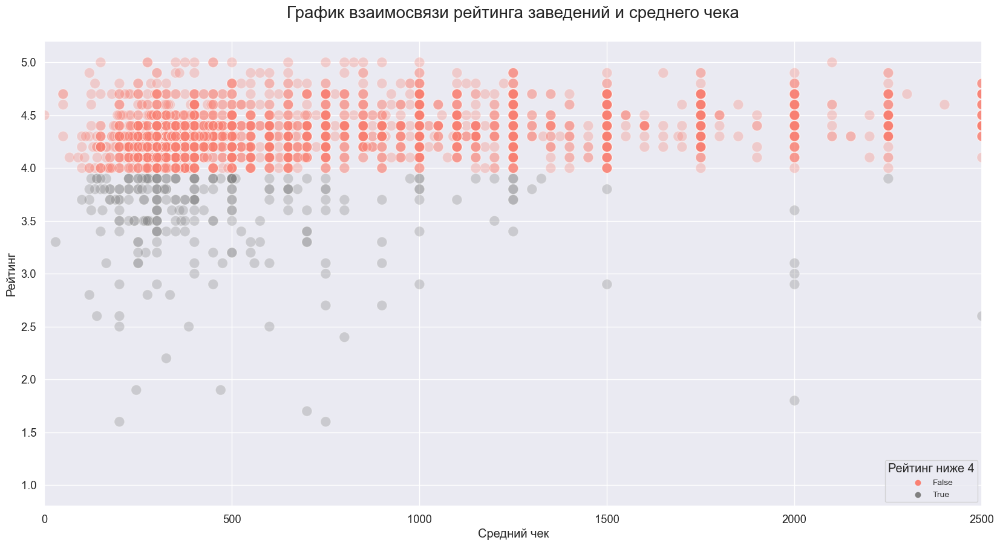

In [60]:
#построим график сравнения средних чеков для заведений с низким рейтингом и всех остальных в разрезе категорий
plt.figure(figsize=(20, 10))
# строим график scatter средствами seaborn
sns.scatterplot(
    x='middle_avg_bill', #по оси х расположим размер среднего чека
    y='rating', #по оси у - рейтинг
    data=data, #данные берем из основного датасета
    hue=data['rating']<4, #выберем признак, что на графике должны быть отличны цвета рейтинга зведений ниже 4
    alpha=0.3, #зададим прозрачность точек
    s=150, #зададим размер точек
    palette=['salmon', 'grey'] #установим палитру цветов
)

plt.xlim(0, 2500) #установим лимит по размеру среднего чека не больше 2500

#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('График взаимосвязи рейтинга заведений и среднего чека\n', fontsize=20)
plt.xlabel('Средний чек')
plt.ylabel('Рейтинг')
# выбираем положение легенды, задаем ее название и указываем размер шрифта
plt.legend(loc='lower right', title='Рейтинг ниже 4', fontsize=10);

Из полученного графика видно, что средний чек заведений с низким рейтингом в основном в районе 500 руб., высокий средний чек у заведений с низким рейтингом встречается крайне редко в отличие от общей массы заведений.

### Общий вывод
<a id="conclusion"></a>

**В данном исследовании мы изучили рынок общепита Москвы, чтобы найти интересные особенности, которые смогут помочь в выборе подходящего места для открытия нового прибыльного заведения. Для этого мы**
- осуществили предобработку имеющихся данных;
- провели анализ категорий заведений, посадочных мест в них;
- изучили соотношение сетевых и несетевых заведений в датасете, а также категорий заведений, которые чаще являются сетевыми;
- выявили топ-15 популярных сетей в Москве и топ-15 улиц по количеству заведений;
- проанализировали заведения в зависимости от расположения в административных округах Москвы и влияния удалённости от центра на цены в заведениях;
- изучили распределение средних рейтингов по категориям заведений, а также проанализировали заведения с низким рейтингом;
- рассмотрели заведения, которые являются единственными объектами общепита на той или иной улице
- осуществили анализ круглосуточных заведений.

**И пришли к следующим выводам:**
- на территории Москвы больше всего заведений из категории кафе, рестораны и кофейни, а также много пабов и баров. Меньше всего булочных и столовых;
- как правило в кафе, кофейнях, ресторанах и пабах количество посадочных мест составляет около 80 ед. В булочных и пиццериях - 50 ед.;
- доля сетевых заведений составляет около 40% от всех. При этом чаще всего сетевыми являются булочные, пиццерии и кофейни;
- самыми популярными среди кофеен является Шоколадница, среди пиццерий - Домино'с Пицца, среди ресторанов - Prime, среди кафе - Кулинарная лавка братьев Караваевых. Среди булочных в Москве есть только одна сеть - Буханка. Все эти заведения объединяет то, что они наслуху, быстрое приготовление еды или продажа уже готовой еды и невысокие средние чеки;
- среди административных округов Москвы больше всего заведений в ЦАО (2 242). В остальных районах количество заведений варируется от 700 до 900, за исключением СЗАО - там около 400 (стоит отметить, что в исследуемых данных представлена информация только по 9 из 12 районов Москвы);
- больше всего пабов и баров среди всех районов Москвы сосредоточено в центре. Как правило, во всех районах Москвы такие категории заведений как кафе, рестораны и кофейни имеют наибольший вес по сравнению с остальными категориями. Меньше всего представлено во всех районах Москвы булочных, столовых и пиццерий;
- средний рейтинг во всех категориях заведений составляет около 4.3 баллов. При этом средний чек заведений с низким рейтингом (меньше 4) как правило ниже, чем общей массе заведений, особенно это заметно среди ресторанов и баров/пабов, а также преимущественно в ЦАО и ЗАО;
- ЦАО имеет больше всего заведений с высоким рейтингом заведений (4.4). Самые низкие рейтинги у заведений расположенных в СВАО и ЮВАО (4.2);
- установлена взаимосвязь низкого рейтинга заведений и низкого среднего чека (в основном до 500 руб.);
- больше всего заведений расположено на улице проспект Мира, кроме того довольно много заведений расположено как на улицах, расположенных на севере Москвы (например, Ленинградский проспект и Дмитровское ш.), так и на юге (Каширское ш. и Варшавское ш.);
- на самых популярных улицах как правило расположены заведения из категории кафе, кофейня и ресторан;
- на некоторых центральных улицах заведений меньше, чем на тех, которые расположены дальше от центра - возможно, это связано с длиной самой улицы или наличием пустых помещений под заведение;
- на 458 улицах Москвы имеется по единственному заведению общепита. Метрики таких заведений соответствуют метрикам всех исследуемых, за исключением доли сетевых - на улицах с единственными объектами их меньше на 10% относительно общей массы;
- самый высокий средний чек в заведениях расположенных в центре и на западе Москвы, а самый низкий - в СВАО, ЮВАО и ЮАО;
- стоить отметить, что в СВАО, помимо низкого среднего чека, заведения имеют самый высокий рейтинг среди других районов Москвы, а также там расположено небольшое их количество, относительно других районов;
- доля заведений, работающих 24/7 составляет около 9%. Больше всего таких заведений расположено в ЦАО, в т.ч. именно в ЦАО больше всего круглосуточных баров/пабов, а также кофеен. По всей Москве больше всего круглосуточных заведений среди категорий кафе, ресторанов и быстрого питания.

### Открытие кофейни
<a id="coffee_house"></a>

Основатели фонда «Shut Up and Take My Money» дополнительно попросили рассмотреть возможность открытия кофейни в Москве, аналогичную как в сериале «Друзья» — такую же крутую и доступную. Заказчики не боятся конкуренции в этой сфере.

Требуется определить, осуществимо ли это.

Сперва ответим на следующие вопросы:
- сколько всего кофеен в датасете;
- в каких районах их больше всего;
- каковы особенности их расположения.

In [61]:
#создадим переменную, в которую отфильтруем из общего датасета данные только по кофейням
coffee_house = data[data['category']=='кофейня'].reset_index()

#сгруппируем полученную таблицу по районам и посчитаем сколько кофеен в каждом, сохранив все это в новой перменной
coffee_house_distr = coffee_house.groupby(
    'district'
).agg(
    'count'
)[
    'name'
].reset_index( #перезапишем индексы
).rename(
    columns={'name':'number'} #дадим корректное наименование столбцу
).sort_values( #отсортируем полученные значения по убыванию
    by='number',
    ascending=False
)

#создаём карту Москвы
m_for_coffee = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=coffee_house_distr, #данные берем из сформированной таблицы
    columns=['district', 'number'],
    key_on='feature.name',
    fill_color='PuRd',
    fill_opacity=0.5,
    legend_name='Количество кофеен в зависимости от района Москвы',
).add_to(m_for_coffee)

#выведем карту и количество кофеен
display(m_for_coffee, f'Количество кофеен на территории Москвы - {len(coffee_house)}')

'Количество кофеен на территории Москвы - 1413'

Итак мы получили, что на территории Москвы (в рамках данного исследования) всего 1 413 кофеен, при этом их большая часть расположена в ЦАО (около 400), чуть меньше в САО (около 200), еще меньше в СВАО, ЗАО и ЮАО. Меньше всего в СЗАО, ЮЗАО, ВАО и ЮВАО. Можно сказать, что на востоке Москвы кофеен почти нет.

Посмотрим еще на столбчатой диаграмме как распределены кофейни по округам:

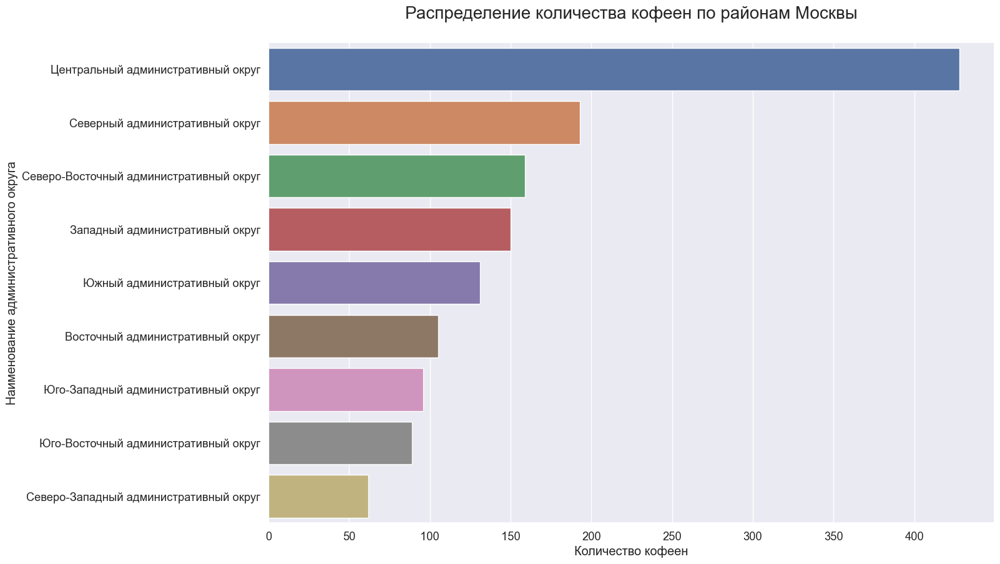

In [62]:
#зададим размер графика
plt.figure(figsize=(15,10))

#строим столбчатую диаграмму по количеству кофеен в каждом и районов Москвы
sns.barplot(
    data=coffee_house_distr,
    x='number', #по оси х отложим количество
    y='district' #по оси у - наименования районов
)

#задаем цветовую палитру
sns.set_palette('pastel')

#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение количества кофеен по районам Москвы\n', fontsize=20)
plt.xlabel('Количество кофеен')
plt.ylabel('Наименование административного округа');

Т.е. меньше всего кофеен в СЗАО, а также на юго-востоке и юго-западе.

Посмотрим имеются ли круглосуточные кофейни:

In [63]:
#сгруппируем данные по признаку работает ли кофейня 24/7 или нет и посчитаем их количество
coffee_house.groupby('is_24/7').agg('count')['name'].reset_index().rename(columns={'name':'number'})

,is_24/7,number
0,False,1354
1,True,59


Круглосуточные кофейни имеются, но их очень мало - всего 59 шт.. Посмотрим где они расположены и сколько их относительно общего числа кофеен в различных районах:

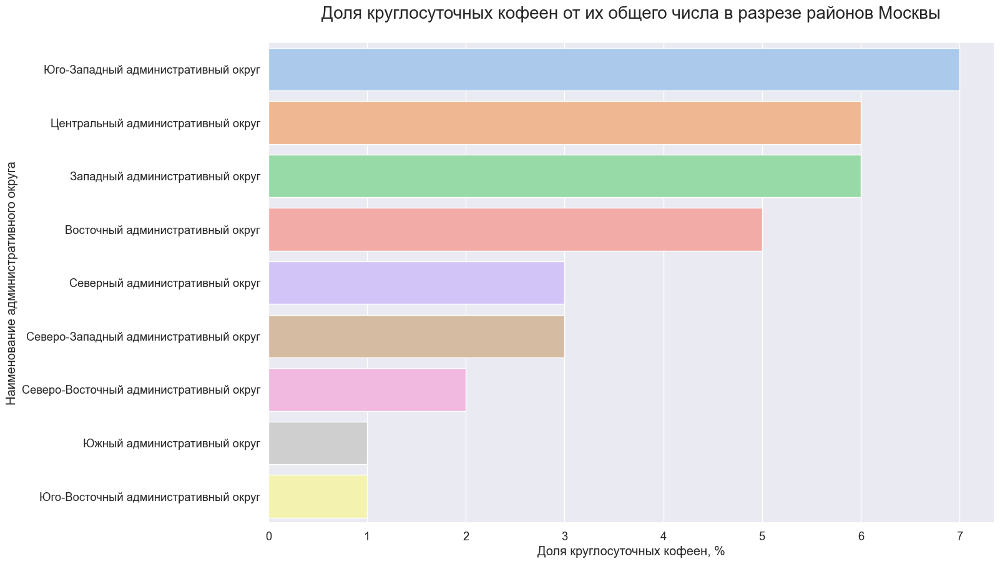

In [64]:
#добавим в общий датасет столбец с количеством круглосутных кафе в каждом районе
coffee_house_distr['number_is_rtc'] = coffee_house[
    coffee_house['is_24/7']==True #фильтруем датасет с кофейнями по работающим круглосуточно
].groupby(
    'district', #группируем по районам
    as_index=False #убираем группировку в качестве индексов
).agg(
    'count' #посчитаем их количество
)['name']

#добавим еще один столбец с долей круглосуточных кофеен от общего их количества
coffee_house_distr['ratio_%'] = round(coffee_house_distr['number_is_rtc'] / coffee_house_distr['number'] * 100, 0)
#отсортируем таблицу по убыванию значения доли круглосуточных кофеен
coffee_house_distr = coffee_house_distr.sort_values(by='ratio_%', ascending=False)

#зададим размер графика
plt.figure(figsize=(15,10))

#строим столбчатую диаграмму по количеству кофеен в каждом и районов Москвы
sns.barplot(
    data=coffee_house_distr,
    x='ratio_%', #по оси х отложим количество
    y='district' #по оси у - наименования районов
)

#задаем цветовую палитру
sns.set_palette('pastel')

#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Доля круглосуточных кофеен от их общего числа в разрезе районов Москвы\n', fontsize=20)
plt.xlabel('Доля круглосуточных кофеен, %')
plt.ylabel('Наименование административного округа');

Исходя из графика можно отметить, что очень низкая доля круглосуточных кофеен в южной части Москвы и на юго-востоке. Больше всего доля кргулосуточных кофеен на юго-западе и в центре.

Посмотрим какие у кофеен рейтинги и как они распределяются по районам и сразу же для наглядности выведем на карту все имеющиеся кофейни с их названием и рейтингом:

In [65]:
#сгруппируем таблицу с данными о кофейнях по районам и посчитаем медианный рейтинг в каждом, сохранив все это в новой перменной
coffee_house_rating = coffee_house.groupby(
    'district'
).agg(
    'median'
)[
    'rating'
].reset_index( #перезапишем индексы
).sort_values( #отсортируем полученные значения по убыванию
    by='rating',
    ascending=False
)

#создаём карту Москвы
m_for_coffee_rating = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=coffee_house_rating, #данные берем из сформированной таблицы
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGnBu',
    fill_opacity=0.5,
    legend_name='Медианный рейтинг кофеен по районам',
).add_to(m_for_coffee_rating)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_for_coffee_rating)
 
# применяем функцию create_clusters() к каждой строке датафрейма
coffee_house.apply(create_clusters, axis=1)

#выведем карту и количество кофеен
m_for_coffee_rating

Медианный рейтинг кофеен варируется между 4.2 и 4.3, что является несущественным отличием, причем рейтинг 4.2 только в ЗАО.

Рассмотрим среднюю стоимость чашки капучино в целом по всем кофейням и в зависимости от района:

In [66]:
#выведем описание столбца с ценами чашки капучино
coffee_house['middle_coffee_cup'].describe()

count     521.000000
mean      175.055662
std        89.753009
min        60.000000
25%       124.000000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

У нас имеются данные всего по 521 заведению. Минимальная стоимость чашки капучино - 60 руб., максимальная - 1 568 руб.. Среднее значение равно 170 руб.. Нужно проверить минимальное и максимальные значения на выбросы:

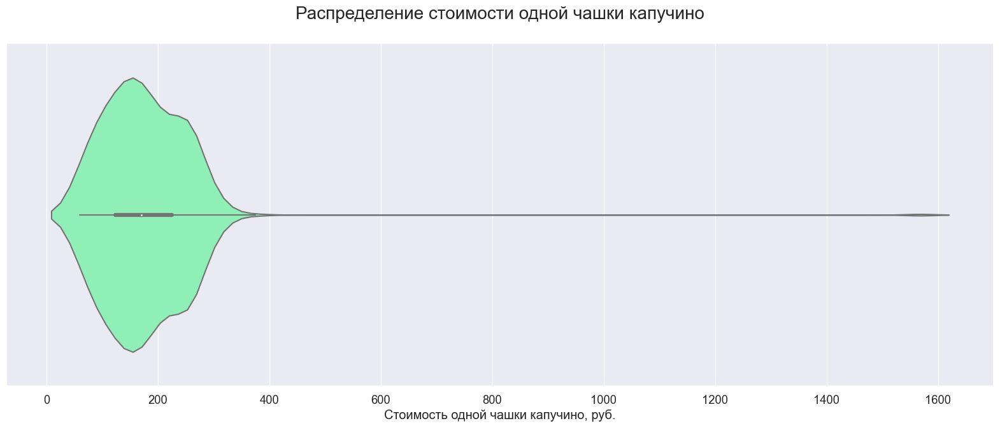

In [67]:
#задаем размер графика
plt.figure(figsize=(20, 7))
#построим ящик с усами
sns.violinplot(data=pd.DataFrame(coffee_house['middle_coffee_cup']), x='middle_coffee_cup', palette='rainbow') 
#формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение стоимости одной чашки капучино\n', fontsize=20)
plt.xlabel('Стоимость одной чашки капучино, руб.');

Видно, что стоимость около 1 600 руб. - это выброс. Посмотрим у какого заведения такая стоимость:

In [68]:
#отсортируем стоимость одной чашки кофе по убыванию и выведем наименования первых 5 кофеен
coffee_house[['name', 'middle_coffee_cup']].sort_values(by='middle_coffee_cup', ascending=False).head()

,name,middle_coffee_cup
535,шоколадница,1568.0
1012,coffee fm,375.0
674,кафетериус,328.0
302,шоколадница,325.0
1089,диемм,320.0


Такая высокая стоимость в Шоколоднице - это явно аномальное значение, т.к. это сетевая компания и если мы выведем медианное значение одной чашки кофе по всей сети, то увидим, что стоимость в 1 600 - не является распространенным значением:

In [69]:
#отфильтруем датафрейм по кофейне Шоколадница и выведем описание значений цены в этом заведении
coffee_house[coffee_house['name']=='Шоколадница']['middle_coffee_cup'].describe()

count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: middle_coffee_cup, dtype: float64

Как видим в среднем стоимость одной чашки капучино в шоколаднице - 256 руб., поэтому можем смело удалять это аномальное значение для анализа.

In [70]:
#удалим аномальное значение Шоколадницы под индексом 535 и перезапишем переменную
coffee_house = coffee_house.drop([535], axis=0)

#выведем описание столбца с ценами чашки капучино
coffee_house['middle_coffee_cup'].describe()

count    520.000000
mean     172.376923
std       65.767854
min       60.000000
25%      124.000000
50%      169.500000
75%      225.000000
max      375.000000
Name: middle_coffee_cup, dtype: float64

Максимальное значение стоимости чашки капучино сильно изменилось и теперь равно 375 руб., а среднее значение поменялось незначительно и составляет 169,5 руб.

Теперь рассмотрим среднюю стоимость 1 чашки капучино в зависимости от района:

In [71]:
#сгруппируем таблицу с данными о кофейнях по районам и посчитаем медианную стоимость 1 чашки капучино для каждого
coffee_house_price = coffee_house.groupby(
    'district'
).agg(
    'median'
)[
    'middle_coffee_cup'
].reset_index( #перезапишем индексы
).sort_values( #отсортируем полученные значения по убыванию
    by='middle_coffee_cup',
    ascending=False
)

#выведем полученную таблицу
coffee_house_price

,district,middle_coffee_cup
7,Юго-Западный административный округ,198.0
5,Центральный административный округ,190.0
1,Западный административный округ,189.0
4,Северо-Западный административный округ,165.0
3,Северо-Восточный административный округ,162.5
2,Северный административный округ,159.0
8,Южный административный округ,150.0
6,Юго-Восточный административный округ,147.5
0,Восточный административный округ,135.0


Отобразим полученные данные на карте, а также на столчатой диаграмме:

In [72]:
#создаём карту Москвы
m_for_coffee_price = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

#создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=coffee_house_price, #данные берем из сформированной таблицы
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Средняя стоимость 1 чашки капучино по районам',
).add_to(m_for_coffee_price)

#выведем карту и количество кофеен
m_for_coffee_price

Самый дорогой кофе в центре, на западе и юго-западе Москвы. Причем ранее мы вявили, что на западе есть ряд кофеен, с низким рейтингом. Дешевле всего кофе в ВАО.

В случае открытия кофейни наиболее оптимальной ценой одной чашки капучино, от которой стоит строить фин. модель, будет являться стоимость между первым и вторым квартилем, или чуть выше первого квартиля и чуть ниже медины, т.е. от 130 до 160 руб. Т.е. мы возьмем стоимость и несильно низкую, которая бы привела к возможному убытку, но и чуть ниже среднего, чтобы могли конкурировать с другими заведениями.

Ранее мы анализировали заведения с [единственными объектами на той или иной улице](#street_one_obj). Возьмем оттуда данные по округам и категориям заведений и построим тепловую карту:

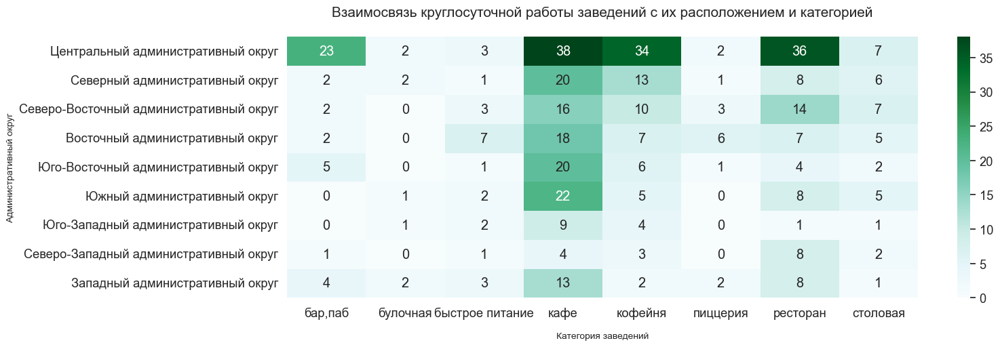

In [73]:
#задаем размер графика
plt.figure(figsize=(15, 5))

#строим хитмэп по данным с заведениями, являющимися единственными на той или иной улице
sns.heatmap(
    one_obj.pivot_table( #создадим сводную таблицу 
        index='district', #по районам
        columns='category', #и категориям заведений
        values='name',
        aggfunc='count' #считаем количество заведений
    ).fillna( #пустые значения заполняем нулями
        0
    ).astype( #приводим к целочисленному типу данных
        'int'
    ).sort_values( #сортируем данные
        by='кофейня', #постолбцу с кофейнями
        ascending=False #в порядке убывания
    ),
    annot=True,
    fmt='d',
    cmap='BuGn' 
) 
#зададим наименования заголовка и подписи осей графика, а также размер шрифта
plt.title('Взаимосвязь круглосуточной работы заведений с их расположением и категорией\n', fontsize=15)
plt.xlabel('\nКатегория заведений', fontsize=10)
plt.ylabel('Административный округ', fontsize=10);

Меньше всего одиночных кофеен в западной части Москвы.

### Рекомендации по открытию кофейни
<a id="coffee_house_recomendation"></a>

Как вариант, **наиболее вероятно рентабельным было бы открытие круглосуточной кофейни на юго-западе Москвы**. Это обусловлено следующими причинами:
- в этом районе нетак много кофеен - около 100, в то время как во многих других районах 150-400;
- скорее всего, из-за того, что там немного кофеен и, соответственно, нет высокой конкуренции в этом районе самая высокая стоимость 1 чашки капучино, порядка 200 руб. А, как мы выше определили, наиболее оптимально устанавливать стоимость 1 чашки капучино от 130 до 160 руб. Можно предположить, что такая стоимость не отобьется, но если взять высокой проходимостью заведения, то вполне возможно, что оно будет прибыльным, т.к. люди будут идти за оптимальной ценой и уютным кафе, как в "Друзьях";
- кроме того, в ЮАО Москвы, который граничит с ЮЗАО, очень малая доля кофеен работающих круглосуточно, т.е. можно было разместить где-то ближе к ЮАО и при этом ближе к центру (маркер с предлагаемым местом открытия размещен на самрй последней карте ниже) в целях большей проходимости;
- еще одной рекомндацией является рассмотреть комбо кофейни с булочной - в Москве их меньше всего среди заведений общепита.

Можно рассмотреть отдельно юго-запад Москвы на карте с отмеченными имеющимися кофейнями на нем:

In [74]:
#southwest_lat - широта точки юго-запада Москвы, southwest_lng - долгота точки юго-запада Москвы
southwest_lat, southwest_lng = 55.662735, 37.576187
#создаём карту с отправной точкой на юго-западе Москвы
m_southwest = Map(location=[southwest_lat, southwest_lng], zoom_start=13)

#создаём хороплет с помощью конструктора Choropleth и добавляем его на карту, выделив только ЮЗАО и заодно ЮАО
Choropleth(
    geo_data=geo_json,
    data=coffee_house_price[ #данные берем из сформированной таблицы по цене 1 чашки капучино
        (
            coffee_house_price['district']=='Юго-Западный административный округ'
        )|(
        coffee_house_price['district']=='Южный административный округ'
        )
    ], 
    columns=['district', 'middle_coffee_cup'],                                 
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Средняя стоимость 1 чашки капучино по районам',
).add_to(m_southwest)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_southwest)
 
# применяем функцию create_clusters() к каждой строке датафрейма, отфильтолвав его по районам ЮЗАО или ЮАО
coffee_house[
    (
        coffee_house['district']=='Юго-Западный административный округ'
    )|(
    coffee_house['district']=='Южный административный округ'
    )
].apply(create_clusters, axis=1)

#выведем карту и количество кофеен
m_southwest

Видно, что в районе улицы Нахимовский проспект почти нет кофеен, при этом там неподалеку расположено метро. **Ниже на карте иным маркером отмечено предлагаемое место для размещения новой кофейни:**

In [75]:
#импортируем собственные иконки
from folium.features import CustomIcon

#сохраняем URL-адрес изображения со значком кофейни с icons8,
#это путь к файлу на сервере icons8
icon_url = 'https://img.icons8.com/?size=512&id=v50XRtm5Zyay&format=png'  
# создаём объект с собственной иконкой размером 30x30
icon = CustomIcon(icon_url, icon_size=(50, 50))
    
#создаём маркер с иконкой icon и добавляем его в кластер
Marker(
    [55.664954, 37.599217],
    icon=icon,
    ).add_to(marker_cluster)


#выведем карту и количество кофеен
m_southwest